In [ ]:
import pandas as pd
import numpy as np
import math

# Mount to google drive
from google.colab import drive
drive.mount('/content/drive/')
import os
os.chdir(r'/content/drive/My Drive/Colab Notebooks/ids705/project')

from ydata_profiling import ProfileReport

from sklearn.preprocessing import LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer

import re

import matplotlib.pyplot as plt
import seaborn as sns

# EDA

## possible feature engineering
- combine `longitude` and `latitude` by haversine since either of them alone could represent location
- `reviews_per month` has too many missing values and most of them are zero (i.e., no reviews), consider to **drop**
- `property_type` and `room_type` has similarities
- response variables is somewhat evenly distributed among bins
- calculated_... can use with room_type, property_type to determine the house type
- bathroom_text can be represented by room_type, maybe I can calculate % accomendates vs. bathroom#
- availability concatenates to 1 variable
- `has_review` indicates whether or not it has reviews
- investigate `amenities` and `reviews`

## variables considered to include

host_acceptance_rate, haversine_location, accomendates,

In [ ]:
train = pd.read_csv("data/train.csv")
test = pd.read_csv("data/test.csv")
data = pd.concat([train, test]).reset_index(drop=True)

In [ ]:
profile = ProfileReport(train, title="profile_report")
profile.to_file("profile_report.pdf")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

/opt/miniconda3/envs/py313/lib/python3.12/site-packages/ydata_profiling/profile_report.py:379: UserWarning: Extension .pdf not supported. For now we assume .html was intended. To remove this warning, please use .html or .json.
  warnings.warn(


Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
test.columns

Index(['id', 'name', 'description', 'property_type', 'neighbourhood_cleansed',
       'neighbourhood_group_cleansed', 'latitude', 'longitude', 'host_since',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_listings_count', 'host_total_listings_count',
       'host_verifications', 'host_has_profile_pic', 'host_identity_verified',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms', 'room_type',
       'accommodates', 'bathrooms', 'bathrooms_text', 'bedrooms', 'beds',
       'amenities', 'has_availability', 'availability_30', 'availability_60',
       'availability_90', 'availability_365', 'instant_bookable',
       'minimum_nights', 'maximum_nights', 'number_of_reviews',
       'number_of_reviews_ltm', 'number_of_reviews_l30d', 'first_review',
       'last_review', 'review_scores

## text variables

### amenities

In [ ]:
# amenities
## clean
import ast
freq_words = ['you', 'on', 'and', 'the', 'or', 'n', 'for', 'with', 'in', 'at']

def clean_amenities(amenities_str):
    try:
        amenities_lst = ast.literal_eval(amenities_str)
    except:
        amenities_lst = []
    amenities_clean = []
    for amenity in amenities_lst:
        # remove special characters and extra spaces
        # e.g., Wi-Fi vs. wifi
        amenity_clean = re.sub(r'[^A-Za-z0-9\s]', '', amenity.lower().strip())
        # Remove freq_words using regex
        pattern = r'\b(?:' + '|'.join(re.escape(word) for word in freq_words) + r')\b'
        amenity_clean = re.sub(pattern, '', amenity_clean)
        # turn air conditioning to ac
        amenity_clean = amenity_clean.replace('air conditioning', 'ac')
        # Remove extra spaces
        amenity_clean = re.sub(r'\s+', ' ', amenity_clean).strip()
        amenities_clean.append(amenity_clean)
    return amenities_clean

train['amenities_clean'] = train['amenities'].apply(clean_amenities)
test['amenities_clean'] = test['amenities'].apply(clean_amenities)
print(train['amenities_clean'])

# amenities count
train['amenities_cnt'] = train['amenities_clean'].apply(lambda x: len(x))
test['amenities_cnt'] = test['amenities_clean'].apply(lambda x: len(x))


0        [dishwasher, single level home, stove, smoke a...
1        [dishwasher, dining table, mini fridge, tv, sm...
2        [cleaning products, elevator, mini fridge, tv,...
3        [kitchen, hot water, dedicated workspace, oven...
4        [tv, smoke alarm, paid parking off premises, h...
                               ...                        
15691    [elevator, dining table, stove, smoke alarm, f...
15692    [shared patio balcony, mosquito net, cleaning ...
15693    [building staff, kitchen, crib, hair dryer, ir...
15694    [dishwasher, crib, tv, smoke alarm, patio balc...
15695    [hailer refrigerator, dishwasher, cleaning pro...
Name: amenities_clean, Length: 15696, dtype: object


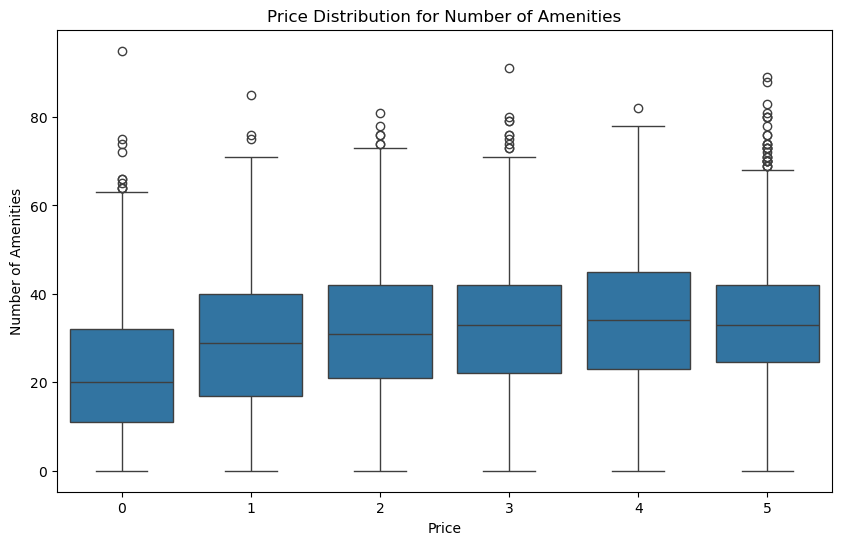

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='price', y='amenities_cnt', data=train)
plt.title('Price Distribution for Number of Amenities')
plt.xlabel('Price')
plt.ylabel('Number of Amenities')
plt.show()

#### LDA
try topic modeling (but the clustering does not make sense)

In [ ]:
# from sklearn.feature_extraction.text import CountVectorizer

# # Join amenities into a single string per listing
# train['amenities_str'] = train['amenities_clean'].apply(lambda x: ' '.join(x))
# test['amenities_str'] = test['amenities_clean'].apply(lambda x: ' '.join(x))

# from sklearn.feature_extraction.text import TfidfVectorizer
# from sklearn.decomposition import NMF
# from sklearn.decomposition import LatentDirichletAllocation

# # Use TF-IDF features
# tfidf_vectorizer = TfidfVectorizer()
# tfidf_train = tfidf_vectorizer.fit_transform(train['amenities_str'])
# tfidf_test = tfidf_vectorizer.transform(test['amenities_str'])

# # Use count features
# vectorizer = CountVectorizer()
# dtm = vectorizer.fit_transform(train['amenities_str'])
# # filter out the count <= 30
# dtm_df = pd.DataFrame(dtm.toarray(), columns=vectorizer.get_feature_names_out())
# mask = ~dtm_df.columns.str.match(r'^\d+$')
# dtm_df = dtm_df.loc[:, mask]
# amenities_sum = dtm_df.sum(axis=0)
# dtm_df = dtm_df.loc[:, amenities_sum[amenities_sum>30].index.tolist()]
# filtered_amenities = dtm_df.columns.tolist()

# # convert to df
# tfidf_train_df = pd.DataFrame(tfidf_train.toarray(), columns=tfidf_vectorizer.get_feature_names_out()).reindex(columns=filtered_amenities).fillna(0)
# tfidf_test_df = pd.DataFrame(tfidf_test.toarray(), columns=tfidf_vectorizer.get_feature_names_out()).reindex(columns=filtered_amenities).fillna(0)

# # # Create the document-term matrix
# # # vectorizer = CountVectorizer()
# # # dtm = vectorizer.fit_transform(train['amenities_str'])

# # # remove infrequent features, remove numeric features
# # dtm_df = pd.DataFrame(dtm.toarray(), columns=vectorizer.get_feature_names_out())
# # dtm_test_df = pd.DataFrame(dtm_test.toarray(), columns=vectorizer.get_feature_names_out())

# mask = ~dtm_df.columns.str.match(r'^\d+$')
# dtm_df = dtm_df.loc[:, mask]
# dtm_test_df = dtm_test_df.loc[:, mask]

# amenities_sum = dtm_df.sum(axis=0)
# dtm_df = dtm_df.loc[:, amenities_sum[amenities_sum>30].index.tolist()]
# amenities_sum = dtm_test_df.sum(axis=0)
# dtm_test_df = dtm_test_df.loc[:, amenities_sum[amenities_sum>30].index.tolist()]
# # # drop unknown columns in test
# # dtm_test_df = dtm_test_df[dtm_test_df.columns.isin(dtm_df.columns)]

# columns_df1 = dtm_df.columns.tolist()

# Create a new DataFrame (filtered_df2) with the same columns as df1
# dtm_test_df = dtm_test_df.reindex(columns=columns_df1).fillna(0)

# put in NMF
# Fit the NMF model
# n_topics = 10
# topic_model = NMF(n_components=n_topics, random_state=42)
# # topic_model = LatentDirichletAllocation(n_components=n_topics, random_state=42)

# amentities_topics_train = topic_model.fit_transform(tfidf_train_df)
# amenities_topics_train_df = pd.DataFrame(amentities_topics_train, columns=[f'amenity_topic_{i}' for i in range(n_topics)])
# amentities_topics_test = topic_model.transform(tfidf_test_df)
# amenities_topics_test_df = pd.DataFrame(amentities_topics_test, columns=[f'amenity_topic_{i}' for i in range(n_topics)])
# # Display the topics
# def display_topics(model, feature_names, num_top_words):
#     for topic_idx, topic in enumerate(model.components_):
#         message = f"Topic {topic_idx}: "
#         message += ", ".join([feature_names[i] for i in topic.argsort()[:-num_top_words - 1:-1]])
#         print(message)
# display_topics(topic_model, filtered_amenities, n_topics)


Topic 0: coffee, cleaning, clothing, storage, products, freezer, kettle, table, water, wine
Topic 1: alarm, kitchen, tv, wifi, carbon, monoxide, smoke, ac, washer, workspace
Topic 2: aid, kit, first, fire, extinguisher, alarm, dedicated, workspace, monoxide, carbon
Topic 3: building, paid, staff, gym, premises, allowed, off, elevator, dryer, checkin
Topic 4: property, security, exterior, cameras, tub, keypad, fire, extinguisher, hot, noise
Topic 5: outdoor, area, grill, bbq, furniture, dining, patio, balcony, private, backyard
Topic 6: allowed, crib, pets, chair, high, entrance, dryer, unit, private, long
Topic 7: bedroom, door, lock, alarm, kitchen, wifi, ac, smart, workspace, dedicated
Topic 8: host, greets, parking, free, cable, standard, street, essentials, dryer, hangers
Topic 9: lockbox, self, checkin, basics, cooking, oven, dishes, silverware, hot, water


#### word2vec

In [ ]:
# from gensim.models import Word2Vec

# # Prepare sentences (each listing's amenities as a sentence)
# sentences = data['amenities_clean'].tolist()

# # Train Word2Vec model
# w2v_model = Word2Vec(sentences, vector_size=50, window=5, min_count=1, workers=4)

# # Get embeddings for amenities
# amenity_embeddings = {amenity: w2v_model.wv[amenity] for amenity in w2v_model.wv.index_to_key}

# # Cluster embeddings
# from sklearn.cluster import KMeans

# amenity_vectors = list(amenity_embeddings.values())
# kmeans = KMeans(n_clusters=7, random_state=42)
# kmeans.fit(amenity_vectors)

# # Map amenities to clusters
# amenity_to_cluster = dict(zip(amenity_embeddings.keys(), kmeans.labels_))


In [ ]:
# amenity_to_cluster

{'smoke alarm': 6,
 'wifi': 5,
 'carbon monoxide alarm': 4,
 'kitchen': 1,
 'hot water': 1,
 'essentials': 4,
 'hangers': 4,
 'hair dryer': 1,
 'iron': 4,
 'refrigerator': 1,
 'dishes silverware': 5,
 'air conditioning': 5,
 'bed linens': 4,
 'cooking basics': 6,
 'heating': 6,
 'dedicated workspace': 5,
 'microwave': 4,
 'tv': 3,
 'shampoo': 5,
 'fire extinguisher': 4,
 'self checkin': 2,
 'long term stays allowed': 1,
 'oven': 5,
 'first aid kit': 5,
 'free street parking': 4,
 'coffee maker': 5,
 'extra pillows blankets': 5,
 'cleaning products': 3,
 'bathtub': 5,
 'freezer': 4,
 'hot water kettle': 1,
 'stove': 3,
 'dining table': 3,
 'exterior security cameras property': 6,
 'wine glasses': 4,
 'toaster': 5,
 'laundromat nearby': 4,
 'private entrance': 4,
 'body soap': 1,
 'shower gel': 6,
 'dishwasher': 3,
 'luggage dropoff allowed': 5,
 'roomdarkening shades': 1,
 'washer': 3,
 'pets allowed': 4,
 'conditioner': 1,
 'lockbox': 5,
 'coffee': 6,
 'lock bedroom door': 4,
 'elevato

#### manual mapping

In [ ]:
amenity_topics = {
    "Kitchen Supplies": [
        "kettle", "coffee machine", "coffee maker", "microwave", "oven", "stove",
        "refrigerator", "dishwasher", "cooking basics", "pots", "pans", "dishes", "silverware",
        "toaster", "blender", "cooker", "fridge"
    ],
    "House Infrastructure": [
        "hot water", "ac", "heating", "dryer", "fireplace", "wifi", "crib",
        "ceiling fan", "iron", "hair dryer", "pillows", "blankets", "room-darkening shades",
        "essential toiletries", "private entrance"
    ],
    "Entertainment": [
        "tv", "streaming services", "game console", "books", "board games",
        "DVD player"
    ],
    "Safety Features": [
        "smoke alarm", "carbon monoxide alarm", "first aid kit", "fire extinguisher",
        "security cameras", "lock on bedroom door", "safe", "emergency exit", "fire blanket"
    ],
    "Outdoor Amenities": [
        "balcony", "patio", "garden", "backyard", "bbq", "outdoor",
        "beach access", "lake access", "hammock", "rooftop"
    ],
    "Luxury Amenities": [
        "tub", "pool", "sauna", "gym", "jacuzzi", "spa", "wine cooler", "dyson", "bosche", "sound system",
        "butler service", "massage", "heated floors", "fitness", "yoga", "piano", "record player", "karaoke machine"
    ],
    "Family-Friendly Amenities": [
        "children's books and toys", "baby", "pet",
        "stroller", "babysitter", "pet"
    ]
}

def map_amenities_to_topics(amenities_list):
    topic_counts = {topic: 0 for topic in amenity_topics.keys()}
    for amenity in amenities_list:
        for topic, amenities in amenity_topics.items():
            if amenity in amenities:
                topic_counts[topic] += 1
    return topic_counts

train['topics_cnt_dict']= train['amenities_clean'].apply(map_amenities_to_topics)
test['topics_cnt_dict']= test['amenities_clean'].apply(map_amenities_to_topics)
train = pd.concat([train.drop('topics_cnt_dict', axis=1), pd.DataFrame(train['topics_cnt_dict'].tolist())], axis=1)
test = pd.concat([test.drop('topics_cnt_dict', axis=1), pd.DataFrame(test['topics_cnt_dict'].tolist())], axis=1)


## description

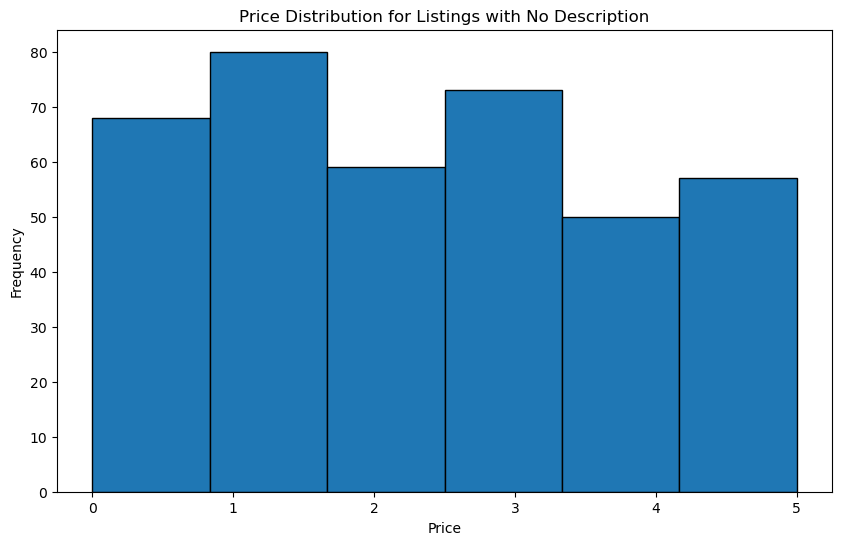

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.hist(train.loc[train['description'].isna(), 'price'], bins=6, edgecolor='black')
plt.title('Price Distribution for Listings with No Description')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

In [ ]:
def clean_description(des):

    pattern = r'[-&]|\b(and|or)\b'

    if des is np.nan:
        des = ''
    else:
        des = re.sub(pattern, '', des, flags=re.IGNORECASE).lower().strip()

    return des

train['description_clean'] = train['description'].apply(clean_description)
test['description_clean'] = test['description'].apply(clean_description)

train['des_len'] = train['description_clean'].apply(lambda x: len(x.split(' ')))
test['des_len'] = test['description_clean'].apply(lambda x: len(x.split(' ')))

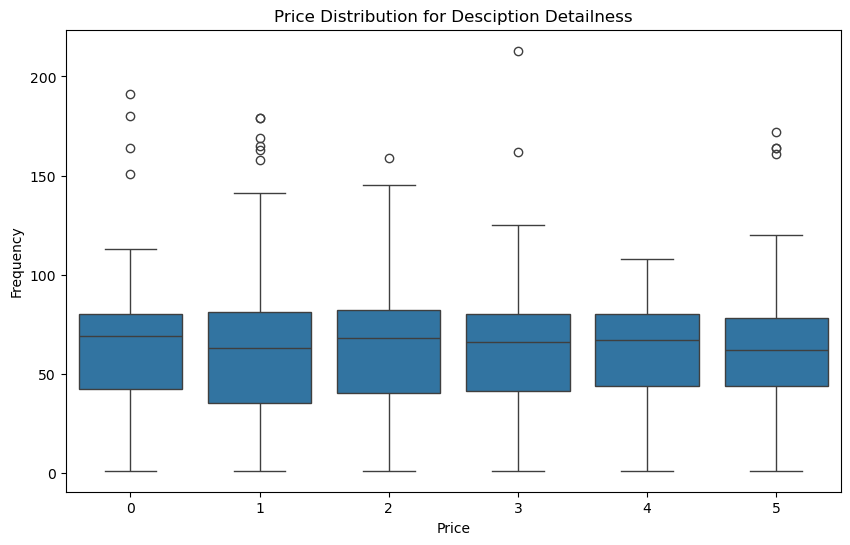

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='price', y='des_len', data=train)
plt.title('Price Distribution for Desciption Detailness')
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.show()

## categorical variables

In [ ]:
train.groupby('neighbourhood_group_cleansed_encoded')['price'].agg(np.mean)

neighbourhood_group_cleansed_encoded
0    1.518760
1    2.110435
2    3.164613
3    1.692821
4    1.642857
Name: price, dtype: float64

In [ ]:
# has_review
train['has_review'] = train['reviews'].notna()
test['has_review'] = test['reviews'].notna()

from sklearn.preprocessing import OrdinalEncoder

# label encoder neighbourhood_cleansed (217 distinct values)
oe_neighbourhood = OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1)
oe_neighbourhood.fit(train[['neighbourhood_cleansed']])

# Transform both training and test data
train['neighbourhood_cleansed_encoded'] = oe_neighbourhood.transform(train[['neighbourhood_cleansed']])
test['neighbourhood_cleansed_encoded'] = oe_neighbourhood.transform(test[['neighbourhood_cleansed']])

# label encoder neighbourhood_group_cleansed (* distinct values)
le_group = LabelEncoder()
train['neighbourhood_group_cleansed_encoded'] = le_group.fit_transform(train['neighbourhood_group_cleansed'])
train.drop(['neighbourhood_cleansed', 'neighbourhood_group_cleansed'], axis=1, inplace=True)

test['neighbourhood_group_cleansed_encoded'] = le_group.transform(test['neighbourhood_group_cleansed'])
test.drop(['neighbourhood_cleansed', 'neighbourhood_group_cleansed'], axis=1, inplace=True)

# room_type
enc = LabelEncoder()
train['room_type_encoded'] = enc.fit_transform(train['room_type'])
test['room_type_encoded'] = enc.transform(test['room_type'])

train.drop('room_type', axis=1, inplace=True)
test.drop('room_type', axis=1, inplace=True)

In [ ]:
# property_type from 59 to 14
def organize_property_type(prop):

    prop = prop.lower()

    # rental
    if 'rental' in prop:

        return 'rental'

    # townhouse, bungalow
    if ('townhouse' in prop) or ('cottage' in prop):

        return 'townhouse'

    if ('bungalow' in prop) or ('villa' in prop) or ('vacation' in prop):

        return 'villa'

    if 'service' in prop:

        return 'serviced'

    # condo
    if 'condo' in prop:

        return 'condo'

    if 'loft' in prop:

        return 'loft'

    if 'hostel' in prop:

        return 'hostel'

    if ('homestay' in prop) or ('breakfast' in prop) or ('casa' in prop):

        return 'homestay'

    if 'tiny' in prop:

        return 'tiny'

    if 'guest' in prop:

        return 'guesthouse'

    if 'camper' in prop:

        return 'camper'

    if ('home' in prop) or ('entire place' in prop):

        return 'home'

    if ('hotel' in prop) or ('resort' in prop):

        return 'hotel'

    else:

        return 'others'

train['property_type_org'] = train['property_type'].apply(organize_property_type)
test['property_type_org'] = test['property_type'].apply(organize_property_type)

enc = OrdinalEncoder(handle_unknown='use_encoded_value', unknown_value=-1)
train['property_type_encoded'] = enc.fit_transform(train[['property_type_org']])
test['property_type_encoded'] = enc.transform(test[['property_type_org']])

In [ ]:
train['host_response_time'] = train['host_response_time'].fillna('unknown')
test['host_response_time'] = test['host_response_time'].fillna('unknown')

enc = LabelEncoder()
train['host_response_time_encoded'] = enc.fit_transform(train['host_response_time'])
test['host_response_time_encoded'] = enc.transform(test['host_response_time'])

In [ ]:
# extract if the bathroom is shared
train['bathroom_shared'] = train['bathrooms_text'].apply(lambda x: 1 if (isinstance(x, str) and re.search('shared', x)) or (x == 0) else 0)
test['bathroom_shared'] = test['bathrooms_text'].apply(lambda x: 1 if (isinstance(x, str) and re.search('shared', x)) or (x == 0) else 0)
train.drop('bathrooms_text', axis=1, inplace=True)
test.drop('bathrooms_text', axis=1, inplace=True)

In [ ]:
# from sklearn.preprocessing import OneHotEncoder
# encoder = OneHotEncoder(sparse_output=False)
# encoder.fit(train[['room_type']])

# train_encoded = encoder.transform(train[['room_type']])
# test_encoded = encoder.transform(test[['room_type']])
# df_train = pd.DataFrame(train_encoded, columns=encoder.get_feature_names_out())
# df_test = pd.DataFrame(test_encoded, columns=encoder.get_feature_names_out())

# # integrate the encoded
# train = pd.concat([train, df_train], axis=1)
# test = pd.concat([test, df_test], axis=1)

In [ ]:
train.groupby('property_type').size().sort_values(ascending=False)

property_type
Entire rental unit                    6516
Private room in rental unit           3943
Private room in home                  1295
Entire home                            716
Private room in townhouse              480
Entire condo                           474
Room in hotel                          432
Private room in condo                  236
Entire townhouse                       216
Entire guest suite                     195
Entire loft                            172
Entire serviced apartment              144
Room in boutique hotel                 124
Shared room in rental unit             112
Private room in serviced apartment      99
Private room in guest suite             87
Private room in loft                    55
Entire place                            46
Private room in bed and breakfast       40
Room in aparthotel                      39
Private room in casa particular         31
Shared room in home                     31
Entire guesthouse                       

## numerical variables

In [ ]:
# How many years the host has been hosting from 2024
train['host_years'] = train['host_since'].apply(lambda x: 2024-int(x.split('-')[0]))
test['host_years'] = test['host_since'].apply(lambda x: 2024-int(x.split('-')[0]))

# from 2008 since aribnb founded, 2008 = year 0, when is the first_review and last_review
# fill NA with -1
train['first_review_recalculated'] = train['first_review'].apply(lambda x: int(x.split('-')[0]) - 2008 + int(x.split('-')[1]) / 12 if isinstance(x, str) else np.nan)
train['last_review_recalculated'] = train['last_review'].apply(lambda x: int(x.split('-')[0]) - 2008 + int(x.split('-')[1]) / 12 if isinstance(x, str) else np.nan)
test['first_review_recalculated'] = test['first_review'].apply(lambda x: int(x.split('-')[0]) - 2008 + int(x.split('-')[1]) / 12 if isinstance(x, str) else np.nan)
test['last_review_recalculated'] = test['last_review'].apply(lambda x: int(x.split('-')[0]) - 2008 + int(x.split('-')[1]) / 12 if isinstance(x, str) else np.nan)

In [ ]:
train['bathrooms'] = train['bathrooms'].fillna(0)
test['bathrooms'] = test['bathrooms'].fillna(0)

train['bathroom_per_accommodate'] = train['bathrooms'] / train['accommodates']
test['bathroom_per_accommodate'] = test['bathrooms'] / test['accommodates']

train['beds'] = train['beds'].fillna(0)
test['beds'] = test['beds'].fillna(0)

train['bed_per_accommodate'] = train['beds'] / train['accommodates']
test['bed_per_accommodate'] = test['beds'] / test['accommodates']

In [ ]:
train['availability_90_ratio'] = train['availability_90']/90
test['availability_90_ratio'] = test['availability_90']/90

train['availability_30_60'] = train.apply(lambda row: row['availability_30'] / row['availability_60'] if row['availability_60']!=0 else 0, axis=1)
test['availability_30_60'] = test.apply(lambda row: row['availability_30'] / row['availability_60'] if row['availability_60']!=0 else 0, axis=1)

#### fill NA

In [ ]:
# ---
# figure out how long the listing might be empty
from datetime import datetime
cur_date = pd.to_datetime('2024-11-01')
train['days_since_last_review'] = (cur_date - pd.to_datetime(train['last_review'])).dt.days
test['days_since_last_review'] = (cur_date - pd.to_datetime(test['last_review'])).dt.days

# ---
fill_zero_feat = ['host_is_superhost', 'beds', 'bathrooms', 'number_of_reviews_ltm']
for feat in fill_zero_feat:
    train[feat] = train[feat].fillna(0)
    test[feat] = test[feat].fillna(0)

# after filling with int 0, the original boolean value would result value error
# convert all to numeric
train['host_is_superhost'] = train['host_is_superhost'].apply(int)
test['host_is_superhost'] = test['host_is_superhost'].apply(int)

# ---
fill_mean_feat = ['host_response_rate', 'host_acceptance_rate', 'review_scores_rating', 'review_scores_accuracy',
                  'review_scores_cleanliness', 'review_scores_checkin', 'review_scores_communication', 'days_since_last_review',
                  'review_scores_location', 'review_scores_value', 'reviews_per_month', 'first_review_recalculated', 'last_review_recalculated']
for feat in fill_mean_feat:
    mean_val = train[feat].mean()
    train[feat] = train[feat].fillna(mean_val)
    test[feat] = test[feat].fillna(mean_val)

# ---
# dummy indicates if have reviews in the past year
train['has_reviews_ltm'] = train['number_of_reviews_ltm'].apply(lambda x: 1 if x!=0 else 0)
test['has_reviews_ltm'] = test['number_of_reviews_ltm'].apply(lambda x: 1 if x!=0 else 0)

In [ ]:
# how many reviews per month in the recent year
train['reviews_per_month_ltm'] = train['number_of_reviews_ltm'] / 12
test['reviews_per_month_ltm'] = test['number_of_reviews_ltm'] / 12

In [ ]:
missing_values = train.isnull().sum()
missing_values[missing_values > 0]

description          387
bedrooms              34
has_availability     118
first_review        4474
last_review         4474
reviews             4474
dtype: int64

In [ ]:
missing_values = test.isnull().sum()
missing_values[missing_values > 0]

description          183
bedrooms              14
has_availability      71
first_review        2027
last_review         2027
reviews             2027
dtype: int64

#### One-hot encoding binerize variables

In [ ]:
# # binerize number_of_reviews since a lot of 0s
# review_bins = [-1, 0, 10, 34, 166, 5000]
# review_labels = ['No reviews', '1-10 reviews', '11-34 reviews', '34-166 reviews', '166+ reviews']

# train['reviews_category'] = pd.cut(train['number_of_reviews'], bins=review_bins, labels=review_labels)
# test['reviews_category'] = pd.cut(test['number_of_reviews'], bins=review_bins, labels=review_labels)

# # one-hot encoding
# from sklearn.preprocessing import OneHotEncoder
# oe_reviews = OneHotEncoder(sparse_output=False)
# oe_reviews.fit(train[['reviews_category']])

# train_encoded = oe_reviews.transform(train[['reviews_category']])
# test_encoded = oe_reviews.transform(test[['reviews_category']])
# reviews_df_train = pd.DataFrame(train_encoded, columns=oe_reviews.get_feature_names_out())
# reviews_df_test = pd.DataFrame(test_encoded, columns=oe_reviews.get_feature_names_out())

# # integrate the encoded
# train = pd.concat([train, reviews_df_train, amenities_topics_train_df], axis=1)
# test = pd.concat([test, reviews_df_test, amenities_topics_test_df], axis=1)


# # binerize number_of_reviews since a lot of 0s
# response_bins = [-1, 0, 75, 100]
# response_labels = ['No response', 'less than 75 response', '75-100 response']

# train['host_response_rate'] = train['host_response_rate'].fillna(0)
# test['host_response_rate'] = test['host_response_rate'].fillna(0)
# train['response_category'] = pd.cut(train['host_response_rate'], bins=response_bins, labels=response_labels)
# test['response_category'] = pd.cut(test['host_response_rate'], bins=response_bins, labels=response_labels)

# # one-hot encoding
# from sklearn.preprocessing import OneHotEncoder
# encoder = OneHotEncoder(sparse_output=False)
# encoder.fit(train[['response_category']])

# train_encoded = encoder.transform(train[['response_category']])
# test_encoded = encoder.transform(test[['response_category']])
# response_df_train = pd.DataFrame(train_encoded, columns=encoder.get_feature_names_out())
# response_df_test = pd.DataFrame(test_encoded, columns=encoder.get_feature_names_out())

# # integrate the encoded
# train = pd.concat([train, response_df_train], axis=1)
# test = pd.concat([test, response_df_test], axis=1)

In [ ]:
# train['host_acceptance_rate'] = train['host_acceptance_rate'].fillna(-1)
# test['host_acceptance_rate'] = test['host_acceptance_rate'].fillna(-1)
# train['review_scores_rating'] = train['review_scores_rating'].fillna(0)
# test['review_scores_rating'] = test['review_scores_rating'].fillna(0)
# train['review_scores_rating'] = train['review_scores_rating'].fillna(0)
# test['review_scores_rating'] = test['review_scores_rating'].fillna(0)
# train['review_scores_accuracy'] = train['review_scores_accuracy'].fillna(0)
# test['review_scores_accuracy'] = test['review_scores_accuracy'].fillna(0)
# train['review_scores_cleanliness'] = train['review_scores_cleanliness'].fillna(0)
# test['review_scores_cleanliness'] = test['review_scores_cleanliness'].fillna(0)
# train['review_scores_cleanliness'] = train['review_scores_cleanliness'].fillna(0)
# test['review_scores_cleanliness'] = test['review_scores_cleanliness'].fillna(0)
# train['review_scores_checkin'] = train['review_scores_checkin'].fillna(0)
# test['review_scores_checkin'] = test['review_scores_checkin'].fillna(0)
# train['review_scores_communication'] = train['review_scores_communication'].fillna(0)
# test['review_scores_communication'] = test['review_scores_communication'].fillna(0)
# train['review_scores_location'] = train['review_scores_location'].fillna(0)
# test['review_scores_location'] = test['review_scores_location'].fillna(0)
# train['review_scores_value'] = train['review_scores_value'].fillna(0)
# test['review_scores_value'] = test['review_scores_value'].fillna(0)
# train['reviews_per_month'] = train['reviews_per_month'].fillna(-1)
# test['reviews_per_month'] = test['reviews_per_month'].fillna(-1)

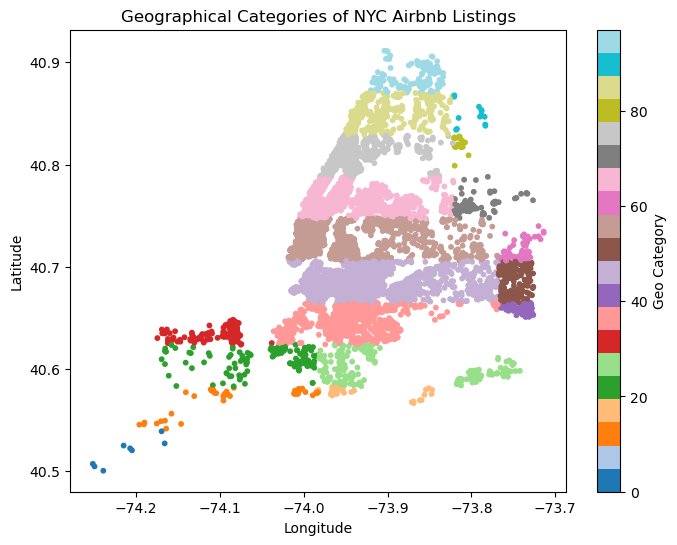

In [ ]:
# Assume 'data' is your DataFrame containing 'longitude' and 'latitude'

# Step 1: Determine data ranges
min_longitude = train['longitude'].min()
max_longitude = train['longitude'].max()
min_latitude = train['latitude'].min()
max_latitude = train['latitude'].max()

# Step 2: Decide on the number of bins
num_bins = 10  # Adjust as needed

# Step 3: Create bin edges
longitude_bins = np.linspace(min_longitude, max_longitude, num_bins + 1)
latitude_bins = np.linspace(min_latitude, max_latitude, num_bins + 1)

# Step 4: Assign to bins
longitude_bin_indices = np.digitize(train['longitude'], longitude_bins) - 1
latitude_bin_indices = np.digitize(train['latitude'], latitude_bins) - 1

# Handle edge cases
longitude_bin_indices[longitude_bin_indices == num_bins] = num_bins - 1
latitude_bin_indices[latitude_bin_indices == num_bins] = num_bins - 1

# Step 5: Combine bins to create geo categories
train['geo_category'] = latitude_bin_indices * num_bins + longitude_bin_indices

##################################
# Step 4: Assign to bins
longitude_bin_indices = np.digitize(test['longitude'], longitude_bins) - 1
latitude_bin_indices = np.digitize(test['latitude'], latitude_bins) - 1

# Handle edge cases
longitude_bin_indices[longitude_bin_indices == num_bins] = num_bins - 1
latitude_bin_indices[latitude_bin_indices == num_bins] = num_bins - 1

# Step 5: Combine bins to create geo categories
test['geo_category'] = latitude_bin_indices * num_bins + longitude_bin_indices

##################################

import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))
scatter = plt.scatter(
    train['longitude'],
    train['latitude'],
    c=train['geo_category'],
    cmap='tab20',
    s=10
)
plt.colorbar(scatter, label='Geo Category')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Geographical Categories of NYC Airbnb Listings')
plt.show()

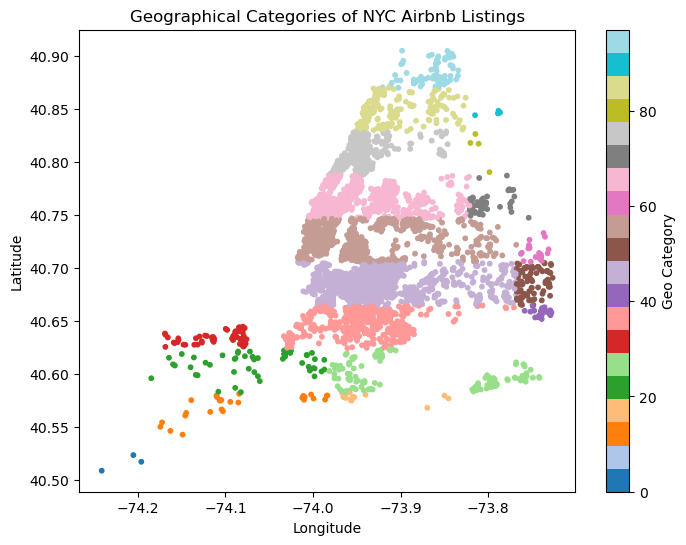

In [ ]:
plt.figure(figsize=(8, 6))
scatter = plt.scatter(
    test['longitude'],
    test['latitude'],
    c=test['geo_category'],
    cmap='tab20',
    s=10
)
plt.colorbar(scatter, label='Geo Category')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Geographical Categories of NYC Airbnb Listings')
plt.show()

In [ ]:
np.unique(train['geo_category'])

array([ 0,  1, 11, 12, 13, 14, 15, 17, 21, 22, 23, 24, 25, 26, 28, 29, 31,
       32, 33, 34, 35, 36, 37, 38, 39, 44, 45, 46, 47, 48, 49, 54, 55, 56,
       57, 58, 59, 64, 65, 66, 67, 68, 69, 75, 76, 77, 78, 85, 86, 87, 88,
       96, 97])

# Feature Selection

In [ ]:
train.columns

Index(['name', 'description', 'property_type', 'price', 'latitude',
       'longitude', 'host_since', 'host_response_time', 'host_response_rate',
       'host_acceptance_rate', 'host_is_superhost', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms', 'room_type',
       'accommodates', 'bathrooms', 'bedrooms', 'beds', 'amenities',
       'has_availability', 'availability_30', 'availability_60',
       'availability_90', 'availability_365', 'instant_bookable',
       'minimum_nights', 'maximum_nights', 'number_of_reviews',
       'number_of_reviews_ltm', 'number_of_reviews_l30d', 'first_review',
       'last_review', 'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', '

In [ ]:
features = ['latitude',
       'longitude', 'host_response_rate',
       'host_acceptance_rate', 'host_is_superhost',
       'host_total_listings_count',
       'availability_90_ratio', 'instant_bookable',
       'minimum_nights', 'maximum_nights', 'number_of_reviews',
       'number_of_reviews_ltm', 'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value', 'reviews_per_month', 'amenities_cnt', 'has_review',
       'neighbourhood_cleansed_encoded',
       'neighbourhood_group_cleansed_encoded', 'room_type_encoded',
       'bathroom_shared',
       # 'Kitchen Supplies',
       # 'House Infrastructure', 'Entertainment', 'Safety Features',
       # 'Outdoor Amenities', 'Luxury Amenities', 'Family-Friendly Amenities',
       'days_since_last_review', 'has_reviews_ltm', 'des_len',
       'bathroom_per_accommodate', 'bed_per_accommodate',
       'property_type_encoded', 'host_response_time_encoded', 'accommodates',
       'reviews_per_month_ltm', 'first_review_recalculated', 'last_review_recalculated',
       'availability_30_60']

In [ ]:
from sklearn.feature_selection import VarianceThreshold

selector = VarianceThreshold(threshold=0.01)
selector.fit(train[features])
selected_features1 = [features[i] for i in range(len(features)) if selector.get_support()[i]]
selected_features1

['host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_total_listings_count',
 'availability_90_ratio',
 'instant_bookable',
 'minimum_nights',
 'maximum_nights',
 'number_of_reviews',
 'number_of_reviews_ltm',
 'review_scores_rating',
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value',
 'reviews_per_month',
 'amenities_cnt',
 'has_review',
 'neighbourhood_cleansed_encoded',
 'neighbourhood_group_cleansed_encoded',
 'room_type_encoded',
 'bathroom_shared',
 'days_since_last_review',
 'has_reviews_ltm',
 'des_len',
 'bathroom_per_accommodate',
 'bed_per_accommodate',
 'property_type_encoded',
 'host_response_time_encoded',
 'accommodates',
 'reviews_per_month_ltm',
 'first_review_recalculated',
 'last_review_recalculated',
 'availability_30_60']

In [ ]:
selected_features1 += ['latitude', 'longitude']

### scale

In [ ]:
from sklearn.preprocessing import StandardScaler
std_scaler = StandardScaler()
train['des_len'] = std_scaler.fit_transform(train[['des_len']]).flatten()
test['des_len'] = std_scaler.transform(test[['des_len']])


### use rf for feature importance

Selected Features: ['longitude', 'host_total_listings_count', 'latitude', 'amenities_cnt', 'accommodates', 'des_len', 'availability_90_ratio', 'bathroom_per_accommodate', 'neighbourhood_cleansed_encoded', 'host_acceptance_rate', 'room_type_encoded', 'availability_30_60', 'bathroom_shared', 'minimum_nights', 'reviews_per_month', 'number_of_reviews', 'days_since_last_review', 'first_review_recalculated', 'maximum_nights', 'review_scores_location', 'bed_per_accommodate', 'review_scores_cleanliness', 'review_scores_value', 'host_response_rate', 'host_response_time_encoded']


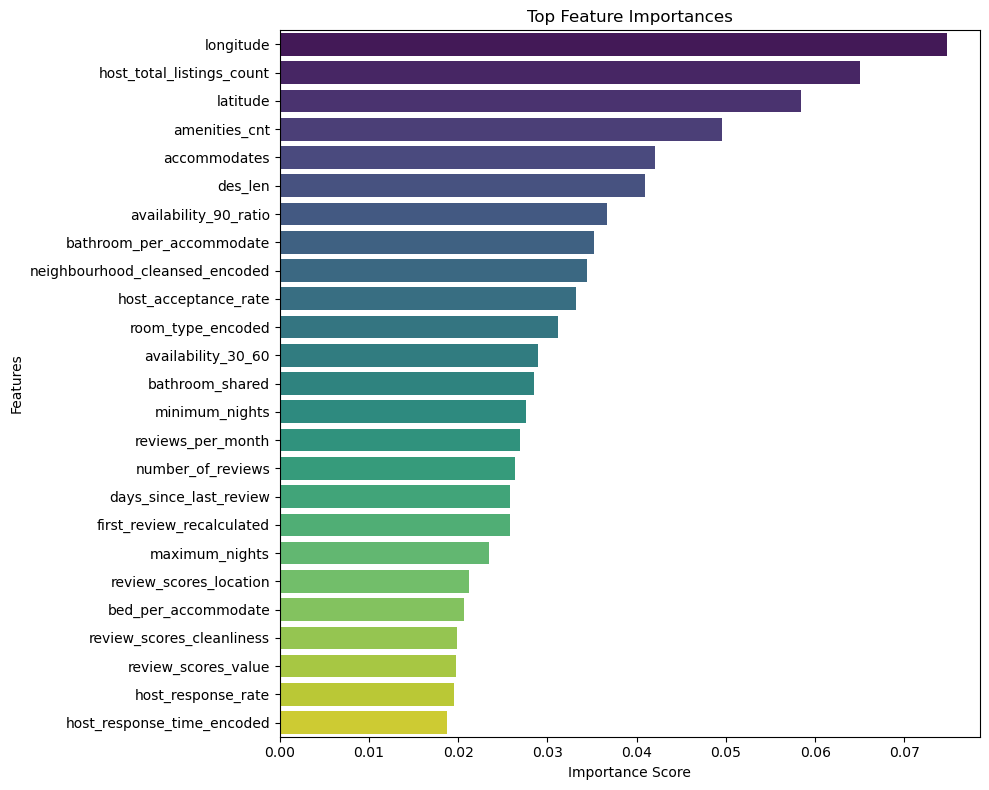

In [ ]:
from sklearn.ensemble import RandomForestClassifier
rf = RandomForestClassifier()
X, y = train[selected_features1], train['price']
rf.fit(X, y)

# Get feature importances
importances = pd.Series(rf.feature_importances_, index=selected_features1)
importances = importances.sort_values(ascending=False)

# Select top N features
N = 25
selected_features2 = importances.head(N).index.tolist()
print("Selected Features:", selected_features2)

import matplotlib.pyplot as plt
import seaborn as sns

# Set the size of the plot
plt.figure(figsize=(10, 8))

# Plot the top N features
sns.barplot(x=importances.head(N), y=importances.head(N).index, palette='viridis')

plt.title('Top Feature Importances')
plt.xlabel('Importance Score')
plt.ylabel('Features')
plt.tight_layout()
plt.show()


## Train Xgboost

In [ ]:
# import xgboost as xgb
# from xgboost import XGBClassifier, XGBRegressor
# from sklearn.model_selection import train_test_split, RandomizedSearchCV, GridSearchCV, cross_val_score
# from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, root_mean_squared_error, make_scorer,mean_squared_error

# X, y = train[selected_features2], train['price']

# X_train, X_val, y_train, y_val = train_test_split(
#     X, y, test_size=0.2, random_state=42
# )

# rmse_scorer = make_scorer(root_mean_squared_error, greater_is_better=False)

# # Hyperparameter grid for XGBoost
# param_grid = {
#     'n_estimators': [500, 1000, 2000],
#     'max_depth': [3, 6, 9, 11],
#     'learning_rate': [0.005, 0.01, 0.05, 0.1],
#     'subsample': [0.6, 0.8, 1.0],
#     'colsample_bytree': [0.6, 0.8, 1.0],
#     'gamma': [0, 0.1, 0.2],
#     'reg_alpha': [0, 0.01, 0.1],
#     'reg_lambda': [1, 1.5, 2],
#     'min_child_weight': [1, 5, 10],
#     'max_delta_step': [0, 1, 5]
# }

# xgb_reg = XGBRegressor(
#     objective='reg:squarederror',
#     random_state=42
# )

# random_search = RandomizedSearchCV(
#     estimator=xgb_reg,
#     param_distributions=param_grid,
#     n_iter=50,                    # Number of parameter settings that are sampled
#     scoring=rmse_scorer,           # Metric to optimize
#     cv=10,                         # 10-fold cross-validation
#     verbose=1,
#     random_state=42,
#     n_jobs=-1                     # Use all available cores
# )

# # Fit the random search model
# random_search.fit(X_train, y_train)

# best_params = random_search.best_params_
# print("Best Hyperparameters:")
# print(random_search.best_params_)
# # Cross-validation with the best parameters
# best_xgb_reg = XGBRegressor(
#     objective='reg:squarederror',
#     random_state=42,
#     early_stopping_rounds=10,
#     **best_params
# )

# # Cross-validate on the training set
# cv_scores = cross_val_score(
#     best_xgb_reg,
#     X_train,
#     y_train,
#     cv=10,
#     scoring=rmse_scorer,
#     n_jobs=-1
# )

# cv_rmse_scores = -cv_scores
# print("Cross-validated RMSE scores:", cv_rmse_scores)
# print("Mean CV RMSE:", cv_rmse_scores.mean())

# # Train the model on the entire training data
# best_xgb_reg.fit(X_train, y_train)

# # Evaluate the model on the test set
# y_pred = best_xgb_reg.predict(X_val)
# test_rmse = root_mean_squared_error(y_val, y_pred)
# print(f"Test RMSE: {test_rmse:.2f}")


Fitting 10 folds for each of 50 candidates, totalling 500 fits


/opt/miniconda3/envs/py313/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Best Hyperparameters:
{'subsample': 0.8, 'reg_lambda': 2, 'reg_alpha': 0, 'n_estimators': 1000, 'min_child_weight': 5, 'max_depth': 9, 'max_delta_step': 1, 'learning_rate': 0.05, 'gamma': 0.2, 'colsample_bytree': 0.8}


ValueError: 
All the 10 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
10 fits failed with the following error:
Traceback (most recent call last):
  File "/opt/miniconda3/envs/py313/lib/python3.12/site-packages/sklearn/model_selection/_validation.py", line 888, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/opt/miniconda3/envs/py313/lib/python3.12/site-packages/xgboost/core.py", line 726, in inner_f
    return func(**kwargs)
           ^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/py313/lib/python3.12/site-packages/xgboost/sklearn.py", line 1108, in fit
    self._Booster = train(
                    ^^^^^^
  File "/opt/miniconda3/envs/py313/lib/python3.12/site-packages/xgboost/core.py", line 726, in inner_f
    return func(**kwargs)
           ^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/py313/lib/python3.12/site-packages/xgboost/training.py", line 182, in train
    if cb_container.after_iteration(bst, i, dtrain, evals):
       ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/py313/lib/python3.12/site-packages/xgboost/callback.py", line 261, in after_iteration
    ret = any(c.after_iteration(model, epoch, self.history) for c in self.callbacks)
          ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/py313/lib/python3.12/site-packages/xgboost/callback.py", line 261, in <genexpr>
    ret = any(c.after_iteration(model, epoch, self.history) for c in self.callbacks)
              ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/miniconda3/envs/py313/lib/python3.12/site-packages/xgboost/callback.py", line 446, in after_iteration
    raise ValueError(msg)
ValueError: Must have at least 1 validation dataset for early stopping.


In [ ]:
def convert_to_classes(y_pred):

    y_pred_round = np.round(y_pred)
    y_pred_clip = np.clip(y_pred_round, 0, 5).astype(int)

    return y_pred_clip
y_pred_clip = convert_to_classes(y_pred)
print(f"Test RMSE: {root_mean_squared_error(y_val, y_pred_clip):.2f}")

Test RMSE: 0.80


In [ ]:
# X_test = test[selected_features3]
# y_test_pred = best_xgb_reg.predict(X_test)
# y_test_pred = convert_to_classes(y_test_pred)
# submission = pd.DataFrame({
#     'id': test['id'],
#     'price': y_test_pred
#     })
# submission.to_csv('submission_xgb.csv', index=False, header=['id', 'price'])

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

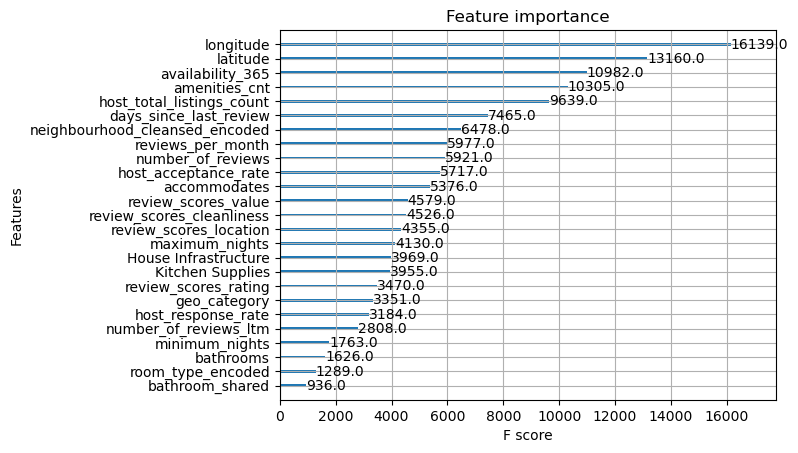

In [ ]:
# from xgboost import plot_importance
# plot_importance(best_xgb_reg)

In [ ]:
# test.columns

Index(['name', 'description', 'property_type', 'price', 'latitude',
       'longitude', 'host_since', 'host_response_time', 'host_response_rate',
       'host_acceptance_rate', 'host_is_superhost', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified',
       'calculated_host_listings_count',
       'calculated_host_listings_count_entire_homes',
       'calculated_host_listings_count_private_rooms',
       'calculated_host_listings_count_shared_rooms', 'room_type',
       'accommodates', 'bathrooms', 'bedrooms', 'beds', 'amenities',
       'has_availability', 'availability_30', 'availability_60',
       'availability_90', 'availability_365', 'instant_bookable',
       'minimum_nights', 'maximum_nights', 'number_of_reviews',
       'number_of_reviews_ltm', 'number_of_reviews_l30d', 'first_review',
       'last_review', 'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', '

# Train ensemble

## XGBoost

In [ ]:
# # Import necessary libraries
# import xgboost as xgb
# from xgboost import XGBRegressor
# from sklearn.model_selection import train_test_split, RandomizedSearchCV
# from sklearn.metrics import root_mean_squared_error, make_scorer
# import pandas as pd

# # Assuming 'train' is your DataFrame and 'selected_features2' is your feature list
# X, y = train[selected_features2], train['price']

# # Split the data
# X_train, X_val, y_train, y_val = train_test_split(
#     X, y, test_size=0.2, random_state=42
# )

# # Define RMSE scorer (negative because lower is better)
# rmse_scorer = make_scorer(root_mean_squared_error, greater_is_better=False)

# # Hyperparameter grid for XGBoost
# param_grid = {
#     'n_estimators': [500, 1000, 2000],
#     'max_depth': [3, 6, 9, 11],
#     'learning_rate': [0.005, 0.01, 0.05, 0.1],
#     'subsample': [0.6, 0.8, 1.0],
#     'colsample_bytree': [0.6, 0.8, 1.0],
#     'gamma': [0, 0.1, 0.2],
#     'reg_alpha': [0, 0.01, 0.1],
#     'reg_lambda': [1, 1.5, 2],
#     'min_child_weight': [1, 5, 10],
#     'max_delta_step': [0, 1, 5]
# }

# xgb_reg = XGBRegressor(
#     objective='reg:squarederror',
#     random_state=42
# )

# # Set up RandomizedSearchCV
# random_search = RandomizedSearchCV(
#     estimator=xgb_reg,
#     param_distributions=param_grid,
#     n_iter=50,
#     scoring=rmse_scorer,
#     cv=10,
#     verbose=1,
#     random_state=42,
#     n_jobs=-1
# )

# # Perform hyperparameter tuning with early stopping
# random_search.fit(
#     X_train, y_train,
# )

# # Best hyperparameters
# best_params = random_search.best_params_
# print("Best Hyperparameters:")
# print(best_params)

# # Retrain the model with best hyperparameters and early stopping
# best_xgb_reg = XGBRegressor(
#     objective='reg:squarederror',
#     random_state=42,
#     **best_params
# )

# # Cross-validate on the training set
# cv_scores = cross_val_score(
#     best_xgb_reg,
#     X_train,
#     y_train,
#     cv=10,
#     scoring=rmse_scorer,
#     n_jobs=-1
# )

# cv_rmse_scores = -cv_scores
# print("Cross-validated RMSE scores:", cv_rmse_scores)
# print("Mean CV RMSE:", cv_rmse_scores.mean())

# best_xgb_reg.fit(
#     X_train, y_train,
#     verbose=0
# )

# # Predict on validation set
# y_pred = best_xgb_reg.predict(X_val)

# # Calculate RMSE
# test_rmse = root_mean_squared_error(y_val, y_pred)
# print(f"XGBoost Validation RMSE: {test_rmse:.2f}")

Fitting 10 folds for each of 50 candidates, totalling 500 fits


/opt/miniconda3/envs/py313/lib/python3.12/site-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Best Hyperparameters:
{'subsample': 0.8, 'reg_lambda': 2, 'reg_alpha': 0, 'n_estimators': 1000, 'min_child_weight': 5, 'max_depth': 9, 'max_delta_step': 1, 'learning_rate': 0.05, 'gamma': 0.2, 'colsample_bytree': 0.8}
Cross-validated RMSE scores: [0.79204571 0.78327337 0.75279287 0.76585704 0.74961208 0.7752965
 0.76572048 0.76220921 0.75186449 0.75847599]
Mean CV RMSE: 0.7657147732414108


TypeError: got an unexpected keyword argument 'squared'

In [ ]:
# # Calculate RMSE
# test_rmse = root_mean_squared_error(y_val, y_pred)
# print(f"XGBoost Validation RMSE: {test_rmse:.2f}")

XGBoost Validation RMSE: 0.77


## Light GBM

In [ ]:
# import lightgbm as lgb
# from lightgbm import LGBMRegressor

# # Hyperparameter grid for LightGBM
# lgb_param_grid = {
#     'n_estimators': [1000, 2000, 3000],
#     'max_depth': [5, 10, 15, -1],
#     'learning_rate': [0.005, 0.01, 0.05],
#     'num_leaves': [31, 63, 127, 255],
#     'subsample': [0.6, 0.8, 1.0],
#     'colsample_bytree': [0.6, 0.8, 1.0],
#     'reg_alpha': [0, 0.1, 0.5],
#     'reg_lambda': [0.5, 1, 1.5],
# }

# lgb_reg = LGBMRegressor(
#     objective='regression',
#     random_state=42,
#     force_col_wise=True
# )

# # Set up RandomizedSearchCV
# lgb_random_search = RandomizedSearchCV(
#     estimator=lgb_reg,
#     param_distributions=lgb_param_grid,
#     n_iter=50,
#     scoring='neg_root_mean_squared_error',
#     cv=5,
#     verbose=1,
#     random_state=42,
#     n_jobs=-1
# )

# # Perform hyperparameter tuning with early stopping
# lgb_random_search.fit(
#     X_train, y_train
# )

# # Best hyperparameters
# lgb_best_params = lgb_random_search.best_params_
# print("Best LightGBM Hyperparameters:")
# print(lgb_best_params)

# # Retrain the model with best hyperparameters
# best_lgb_reg = LGBMRegressor(
#     objective='regression',
#     random_state=42,
#     **lgb_best_params
# )

# best_lgb_reg.fit(
#     X_train, y_train,
#     verbose=0
# )

# # Predict on validation set
# y_pred_lgb = best_lgb_reg.predict(X_val)

# # Calculate RMSE
# rmse_lgb = root_mean_squared_error(y_val, y_pred_lgb)
# print(f"LightGBM Validation RMSE: {rmse_lgb:.2f}")

Fitting 5 folds for each of 50 candidates, totalling 250 fits
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Total Bins 2828
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of data points in the train set: 10045, number of used features: 25
[LightGBM] [Info] Total Bins 2824
[LightGBM] [Info] Total Bins 2831
[LightGBM] [Info] Number of data points in the train set: 10045, number of used features: 25
[LightGBM] [Info] Number of data points in the train set: 10045, number of used features: 25
[LightGBM] [Info] Start training from score 2.459034
[LightGBM] [Info] Total Bins 2828
[LightGBM] [Info] Total Bins 2820
[LightGBM] [Info] Number of data poi

KeyboardInterrupt: 

In [ ]:
# import lightgbm as lgb
# from sklearn.model_selection import RandomizedSearchCV, train_test_split

# # Assuming 'train' is your DataFrame and 'selected_features2' is your feature list
# X, y = train[selected_features2], train['price']

# # Split the data
# X_train, X_val, y_train, y_val = train_test_split(
#     X, y, test_size=0.2, random_state=42
# )

# # Simplified hyperparameter grid
# lgb_param_grid = {
#     'n_estimators': [500],
#     'max_depth': [6, 8],
#     'learning_rate': [0.05, 0.1],
#     'num_leaves': [31, 63],
#     'subsample': [0.8],
#     'colsample_bytree': [0.8],
#     'reg_alpha': [0.0],
#     'reg_lambda': [0.0],
#     'min_child_weight': [1],
# }

# n_iter_search = 10  # Number of parameter settings that are sampled
# cv_folds = 5        # Number of cross-validation folds

# # Define the model
# lgb_reg = lgb.LGBMRegressor(
#     objective='regression',
#     force_col_wise=True,
#     random_state=42,
#     n_jobs=-1  # Use all available CPU cores
# )

# # Set up RandomizedSearchCV
# lgb_random_search = RandomizedSearchCV(
#     estimator=lgb_reg,
#     param_distributions=lgb_param_grid,
#     n_iter=n_iter_search,
#     scoring='neg_root_mean_squared_error',
#     cv=cv_folds,
#     verbose=1,
#     random_state=42,
#     n_jobs=-1
# )

# # Perform hyperparameter tuning with early stopping
# lgb_random_search.fit(
#     X_train, y_train
# )

# # Best hyperparameters
# lgb_best_params = lgb_random_search.best_params_
# print("Best LightGBM Hyperparameters:")
# print(lgb_best_params)

# # Retrain the model with best hyperparameters
# best_lgb_reg = lgb.LGBMRegressor(
#     objective='regression',
#     random_state=42,
#     n_jobs=-1,
#     **lgb_best_params
# )

# best_lgb_reg.fit(
#     X_train, y_train
# )

# # Predict on validation set
# y_pred_lgb = best_lgb_reg.predict(X_val)

# # Calculate RMSE
# rmse_lgb = root_mean_squared_error(y_val, y_pred_lgb)
# print(f"LightGBM Validation RMSE: {rmse_lgb:.2f}")

Fitting 5 folds for each of 8 candidates, totalling 40 fits


/opt/miniconda3/envs/py313/lib/python3.12/site-packages/sklearn/model_selection/_search.py:320: UserWarning: The total space of parameters 8 is smaller than n_iter=10. Running 8 iterations. For exhaustive searches, use GridSearchCV.
  warnings.warn(


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Total Bins 2820
[LightGBM] [Info] Number of data points in the train set: 10044, number of used features: 25
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Total Bins 2821
[LightGBM] [Info] Start training from score 2.474512
[LightGBM] [Info] Number of data points in the train set: 10045, number of used features: 25
[LightGBM] [Info] Total Bins 2828
[LightGBM] [Info] Number of data points in the train set: 10045, number of used features: 25
[LightGBM] [Info] Total Bins 2824
[LightGBM] [Info] Number of data points in the train set: 10045, number of used features: 25
[LightGBM] [Info] Start training from score 2.465406
[LightGBM] [Info] Start training from score 2.459034
[LightGBM] [I

## RF

In [ ]:
# from sklearn.ensemble import RandomForestRegressor

# # Hyperparameter grid for Random Forest
# rf_param_grid = {
#     'n_estimators': [100, 200, 300, 500],
#     'max_depth': [5, 10, 15, 20, None],
#     'min_samples_split': [2, 5, 10, 20],
#     'min_samples_leaf': [1, 2, 4],
#     'max_features': ['sqrt', 'log2', 0.3, 0.5],
#     'bootstrap': [True, False]
# }

# rf_reg = RandomForestRegressor(random_state=42)

# # Set up RandomizedSearchCV
# rf_random_search = RandomizedSearchCV(
#     estimator=rf_reg,
#     param_distributions=rf_param_grid,
#     n_iter=50,
#     scoring='neg_root_mean_squared_error',
#     cv=5,
#     verbose=1,
#     random_state=42,
#     n_jobs=-1
# )

# # Perform hyperparameter tuning
# rf_random_search.fit(X_train, y_train)

# # Best hyperparameters
# rf_best_params = rf_random_search.best_params_
# print("Best Random Forest Hyperparameters:")
# print(rf_best_params)

# # Retrain the model with best hyperparameters
# best_rf_reg = RandomForestRegressor(
#     random_state=42,
#     **rf_best_params
# )

# best_rf_reg.fit(X_train, y_train)

# # Predict on validation set
# y_pred_rf = best_rf_reg.predict(X_val)

# # Calculate RMSE
# rmse_rf = root_mean_squared_error(y_val, y_pred_rf)
# print(f"Random Forest Validation RMSE: {rmse_rf:.2f}")

Fitting 5 folds for each of 50 candidates, totalling 250 fits
Best Random Forest Hyperparameters:
{'n_estimators': 300, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': 0.5, 'max_depth': 20, 'bootstrap': False}
Random Forest Validation RMSE: 0.79


## Combine

In [ ]:
# y_pred_xgb = best_xgb_reg.predict(X_val)
# # Ensemble predictions by averaging
# y_pred_ensemble = (y_pred_xgb + y_pred_lgb + y_pred_rf) / 3

# # Calculate RMSE for ensemble
# rmse_ensemble = root_mean_squared_error(y_val, y_pred_ensemble)

# print(f"Ensemble Validation RMSE: {rmse_ensemble:.2f}")
# print(f"XGBoost Validation RMSE: {test_rmse:.2f}")
# print(f"LightGBM Validation RMSE: {rmse_lgb:.2f}")
# print(f"Random Forest Validation RMSE: {rmse_rf:.2f}")
# print(f"Ensemble Validation RMSE: {rmse_ensemble:.2f}")

# # Calculate weights based on validation RMSE
# total_rmse = 1 / test_rmse + 1 / rmse_lgb + 1 / rmse_rf
# weights = [
#     (1 / test_rmse) / total_rmse,
#     (1 / rmse_lgb) / total_rmse,
#     (1 / rmse_rf) / total_rmse
# ]

# # Weighted ensemble predictions
# y_pred_weighted = (
#     y_pred_xgb * weights[0] +
#     y_pred_lgb * weights[1] +
#     y_pred_rf * weights[2]
# )

# rmse_weighted = root_mean_squared_error(y_val, y_pred_weighted)
# print(f"Weighted Ensemble Validation RMSE: {rmse_weighted:.2f}")

Ensemble Validation RMSE: 0.76
XGBoost Validation RMSE: 0.77
LightGBM Validation RMSE: 0.77
Random Forest Validation RMSE: 0.79
Ensemble Validation RMSE: 0.76
Weighted Ensemble Validation RMSE: 0.76


In [ ]:
# X_test = test[selected_features2]
# y_test_xgb = best_xgb_reg.predict(X_test)
# y_test_lgm = best_lgb_reg.predict(X_test)
# y_test_rf = best_rf_reg.predict(X_test)

# y_pred_weighted = (
#     y_test_xgb * weights[0] +
#     y_test_lgm * weights[1] +
#     y_test_rf * weights[2]
# )

# def convert_to_classes(y_pred):

#     y_pred_round = np.round(y_pred)
#     y_pred_clip = np.clip(y_pred_round, 0, 5).astype(int)

#     return y_pred_clip
# # Calculate RMSE
# y_pred = convert_to_classes(y_pred_weighted)

# submission = pd.DataFrame({
#     'id': test['id'],
#     'price': y_pred
#     })
# submission.to_csv('submission.csv', index=False, header=['id', 'price'])

In [ ]:
# y_pred_ensemble_test = (y_test_xgb + y_test_lgm + y_test_rf) / 3

# submission = pd.DataFrame({
#     'id': test['id'],
#     'price': y_pred_ensemble_test
#     })
# submission.to_csv('submission.csv', index=False, header=['id', 'price'])

In [ ]:
# y_test_rf[3]

1.199888888888889

# Train Stack Regressor

In [ ]:
import pandas as pd
import numpy as np

# Models
import xgboost as xgb
from xgboost import XGBRegressor
import lightgbm as lgb
from lightgbm import LGBMRegressor
from sklearn.ensemble import RandomForestRegressor, StackingRegressor

# Hyperparameter tuning and cross-validation
from sklearn.model_selection import train_test_split, RandomizedSearchCV, cross_val_score, KFold
from sklearn.metrics import root_mean_squared_error, make_scorer
import tensorflow as tf

# Suppress warnings
import warnings
warnings.filterwarnings('ignore')

X_train_full = train[selected_features2]
y_train_full = train['price']

# Split the data into training and validation sets

# Define RMSE scorer (negative because lower is better)
rmse_scorer = make_scorer(root_mean_squared_error, greater_is_better=False)

cv = KFold(n_splits=10, shuffle=True, random_state=42)

# Hyperparameter grid for XGBoost
xgb_param_grid = {
    'n_estimators': [1500, 2000, 2500],
    'max_depth': [7, 9, 11],
    'learning_rate': [0.01, 0.005],
    'subsample': [0.8, 0.9, 1],
    'colsample_bytree': [0.8, 0.9, 1],
    'gamma': [0.2],
    'reg_alpha': [0.1],
    'reg_lambda': [1.5, 2.0],
    'min_child_weight': [7],
}

xgb_reg = XGBRegressor(
    objective='reg:squarederror',
    random_state=42
)

# RandomizedSearchCV for XGBoost
xgb_random_search = RandomizedSearchCV(
    estimator=xgb_reg,
    param_distributions=xgb_param_grid,
    n_iter=20,
    scoring=rmse_scorer,
    cv=cv,
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Perform hyperparameter tuning
xgb_random_search.fit(X_train_full, y_train_full)

# Best hyperparameters
xgb_best_params = xgb_random_search.best_params_
print("Best XGBoost Hyperparameters:")
print(xgb_best_params)
best_xgb_reg = XGBRegressor(
    objective='reg:squarederror',
    random_state=42,
    **xgb_best_params
)


Fitting 10 folds for each of 20 candidates, totalling 200 fits
Best XGBoost Hyperparameters:
{'subsample': 0.8, 'reg_lambda': 1.5, 'reg_alpha': 0.1, 'n_estimators': 2000, 'min_child_weight': 7, 'max_depth': 9, 'learning_rate': 0.01, 'gamma': 0.2, 'colsample_bytree': 0.9}


n_estimators: 500, Validation RMSE: 0.7609
n_estimators: 1000, Validation RMSE: 0.7473
n_estimators: 1500, Validation RMSE: 0.7442
n_estimators: 2000, Validation RMSE: 0.7437
n_estimators: 2500, Validation RMSE: 0.7433


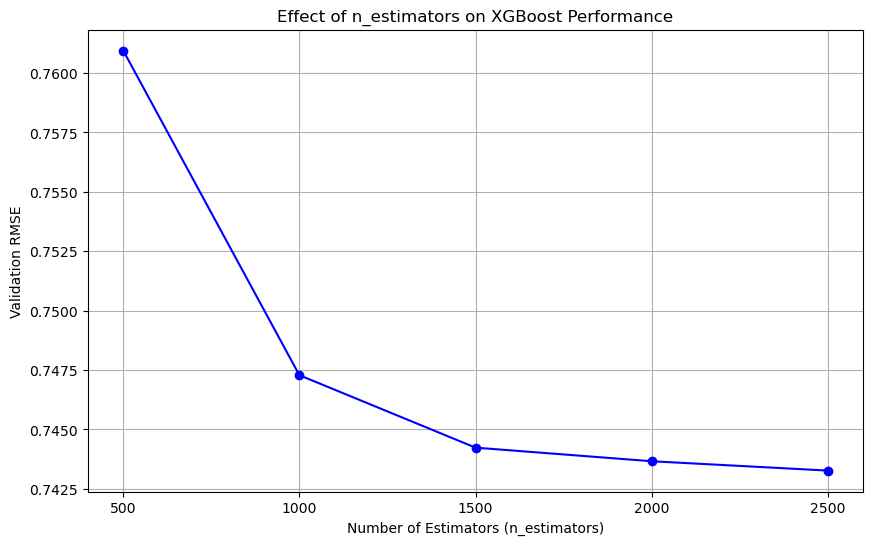

In [ ]:
# Assume 'train' is your DataFrame and 'selected_features2' is your feature list
X = train[selected_features2]
y = train['price']

# Split the data into training and validation subsets
X_train_subset, X_val_subset, y_train_subset, y_val_subset = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Hyperparameters to test
n_estimators_list = [500, 1000, 1500, 2000, 2500]

# Store results
rmse_list = []

# Loop over different n_estimators
for n_estimators in n_estimators_list:
    xgb_reg = XGBRegressor(
        n_estimators=n_estimators,
        max_depth=9,
        learning_rate=0.01,
        subsample=0.8,
        colsample_bytree=0.8,
        gamma=0.2,
        reg_alpha=0.1,
        reg_lambda=1.5,
        min_child_weight=7,
        objective='reg:squarederror',
        random_state=42,
        n_jobs=-1,
        verbosity=0
    )

    # Fit the model
    xgb_reg.fit(X_train_subset, y_train_subset)

    # Predict on validation set
    y_pred = xgb_reg.predict(X_val_subset)

    # Calculate RMSE
    rmse = root_mean_squared_error(y_val_subset, y_pred)
    rmse_list.append(rmse)
    print(f"n_estimators: {n_estimators}, Validation RMSE: {rmse:.4f}")

# Plotting
plt.figure(figsize=(10, 6))
plt.plot(n_estimators_list, rmse_list, marker='o', linestyle='-', color='b')
plt.title('Effect of n_estimators on XGBoost Performance')
plt.xlabel('Number of Estimators (n_estimators)')
plt.ylabel('Validation RMSE')
plt.xticks(n_estimators_list)
plt.grid(True)
plt.show()

In [ ]:
# Hyperparameter grid for LightGBM
lgb_param_grid = {
    'n_estimators': [500, 1000, 2000],
    'learning_rate': [0.01, 0.05, 0.1],
    'num_leaves': [31, 63, 127],
    'max_depth': [-1, 5, 10],
    'min_child_samples': [20, 50, 100],
    'subsample': [0.7, 0.9, 1.0],
    'colsample_bytree': [0.7, 0.9, 1.0],
    'reg_alpha': [0.0, 0.1, 0.5],
    'reg_lambda': [0.0, 0.1, 0.5],
    'min_split_gain': [0.0, 0.1],
}

lgb_reg = LGBMRegressor(
    objective='regression',
    random_state=42,
    force_col_wise=True
)

# RandomizedSearchCV for LightGBM
lgb_random_search = RandomizedSearchCV(
    estimator=lgb_reg,
    param_distributions=lgb_param_grid,
    n_iter=20,
    scoring=rmse_scorer,
    cv=cv,
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Perform hyperparameter tuning
lgb_random_search.fit(X_train_full, y_train_full)

# Best hyperparameters
lgb_best_params = lgb_random_search.best_params_
print("Best LightGBM Hyperparameters:")
print(lgb_best_params)

best_lgb_reg = LGBMRegressor(
    objective='regression',
    random_state=42,
    **lgb_best_params
)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
[LightGBM] [Info] Total Bins 3083
[LightGBM] [Info] Total Bins 3090
[LightGBM] [Info] Number of data points in the train set: 14126, number of used features: 25
[LightGBM] [Info] Number of data points in the train set: 14126, number of used features: 25
[LightGBM] [Info] Start training from score 2.463472
[LightGBM] [Info] Start training from score 2.464604
[LightGBM] [Info] Total Bins 3087
[LightGBM] [Info] Number of data points in the train set: 14126, number of used features: 25
[LightGBM] [Info] Start training from score 2.469489
[LightGBM] [Info] Total Bins 3077
[LightGBM] [Info] Number of data points in the train set: 14126, number of used features: 25
[LightGBM] [Info] Start training from score 2.462268
[LightGBM] [Info] Total Bins 3078
[LightGBM] [Info] Number of data points in the train set: 14126, number of used features: 25
[LightGBM] [Info] Total Bins 3093
[LightGBM] [Info] Number of data points in the train set

In [ ]:
# Hyperparameter grid for Random Forest
rf_param_grid = {
    'n_estimators': [200, 500, 1000],
    'max_depth': [10, 20, 25],
    'max_features': ['sqrt', 'log2', 0.8],
    'min_samples_split': [2],
    'min_samples_leaf': [1],
}

rf_reg = RandomForestRegressor(random_state=42)

# RandomizedSearchCV for Random Forest
rf_random_search = RandomizedSearchCV(
    estimator=rf_reg,
    param_distributions=rf_param_grid,
    n_iter=20,
    scoring=rmse_scorer,
    cv=cv,
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Perform hyperparameter tuning
rf_random_search.fit(X_train_full, y_train_full)

# Best hyperparameters
rf_best_params = rf_random_search.best_params_
print("Best Random Forest Hyperparameters:")
print(rf_best_params)
best_rf_reg = RandomForestRegressor(
    random_state=42,
    **rf_best_params
)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
Best Random Forest Hyperparameters:
{'n_estimators': 500, 'min_samples_split': 2, 'min_samples_leaf': 1, 'max_features': 0.8, 'max_depth': 25}


In [ ]:
from catboost import CatBoostRegressor

cat_param_grid = {
    'iterations': [500, 1000, 2000],
    'learning_rate': [0.01, 0.05, 0.1],
    'depth': [4, 6, 10],
    'l2_leaf_reg': [1, 3, 5],
    'bagging_temperature': [0, 1, 3],
    'border_count': [32, 64, 128],
}

cat_reg = CatBoostRegressor(random_state=42)

# RandomizedSearchCV for Random Forest
cat_random_search = RandomizedSearchCV(
    estimator=cat_reg,
    param_distributions=cat_param_grid,
    n_iter=20,
    scoring=rmse_scorer,
    cv=cv,
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Perform hyperparameter tuning
cat_random_search.fit(X_train_full, y_train_full)

# Best hyperparameters
cat_best_params = cat_random_search.best_params_
print("Best CatBoost Hyperparameters:")
print(cat_best_params)
best_cat_reg = CatBoostRegressor(
    random_state=42,
    **cat_best_params
)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
0:	learn: 1.7013634	total: 79.2ms	remaining: 1m 19s
0:	learn: 1.6996823	total: 95ms	remaining: 1m 34s
0:	learn: 1.6989009	total: 95.2ms	remaining: 1m 35s
0:	learn: 1.6987394	total: 87ms	remaining: 1m 26s
0:	learn: 1.6964412	total: 85.7ms	remaining: 1m 25s
0:	learn: 1.6972721	total: 95ms	remaining: 1m 34s
0:	learn: 1.6963945	total: 98ms	remaining: 1m 37s
0:	learn: 1.6992043	total: 117ms	remaining: 1m 57s
1:	learn: 1.6905437	total: 108ms	remaining: 54s
1:	learn: 1.6856984	total: 117ms	remaining: 58.4s
1:	learn: 1.6883426	total: 133ms	remaining: 1m 6s
1:	learn: 1.6879896	total: 125ms	remaining: 1m 2s
1:	learn: 1.6887981	total: 137ms	remaining: 1m 8s
1:	learn: 1.6856855	total: 139ms	remaining: 1m 9s
1:	learn: 1.6867125	total: 138ms	remaining: 1m 8s
2:	learn: 1.6797774	total: 136ms	remaining: 45.1s
1:	learn: 1.6883457	total: 155ms	remaining: 1m 17s
2:	learn: 1.6750043	total: 166ms	remaining: 55.2s
2:	learn: 1.6772360	total: 157m

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor
etr_param_grid = {
    'n_estimators': [100, 300],
    'max_depth': [None, 10, 20],
    'max_features': ['auto', 'sqrt'],
}

etr_reg = ExtraTreesRegressor(random_state=42)

# RandomizedSearchCV for Random Forest
etr_random_search = RandomizedSearchCV(
    estimator=etr_reg,
    param_distributions=etr_param_grid,
    n_iter=20,
    scoring=rmse_scorer,
    cv=cv,
    verbose=1,
    random_state=42,
    n_jobs=-1
)

# Perform hyperparameter tuning
etr_random_search.fit(X_train_full, y_train_full)

# Best hyperparameters
etr_best_params = etr_random_search.best_params_
print("Best CatBoost Hyperparameters:")
print(etr_best_params)
best_etr_reg = ExtraTreesRegressor(
    random_state=42,
    **etr_best_params
)
# Initialize the Extra Trees Regressor with the predefined parameters
best_etr_reg = ExtraTreesRegressor(**etr_best_params)

Fitting 10 folds for each of 12 candidates, totalling 120 fits


Best CatBoost Hyperparameters:
{'n_estimators': 300, 'max_features': 'sqrt', 'max_depth': None}


In [ ]:
etr_param_grid = {
    'n_estimators': 800,
    'max_depth': 20,
    'min_samples_split': 2,
    'min_samples_leaf': 2,
    'max_features': 0.8,
    'max_leaf_nodes': None,
    'min_impurity_decrease': 0.05,
    'bootstrap': False,
    'criterion': 'squared_error',
    'random_state': 42
}
best_etr_reg = ExtraTreesRegressor(**etr_param_grid)

In [ ]:
best_xgb_reg = XGBRegressor(
    objective='reg:squarederror',
    random_state=42,
    **xgb_best_params
)

# # Cross-validation scores
# xgb_cv_scores = cross_val_score(
#     best_xgb_reg,
#     X_train_full,
#     y_train_full,
#     cv=cv,
#     scoring=rmse_scorer,
#     n_jobs=-1
# )

# xgb_cv_rmse_scores = -xgb_cv_scores
# print("XGBoost Cross-validated RMSE scores:", xgb_cv_rmse_scores)
# print("XGBoost Mean CV RMSE:", xgb_cv_rmse_scores.mean())

# Fit the model on the entire training data
best_xgb_reg.fit(X_train_full, y_train_full)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.9, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.2, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=9, max_leaves=None,
             min_child_weight=7, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=2000, n_jobs=None,
             num_parallel_tree=None, random_state=42, ...)

In [ ]:
best_lgb_reg = LGBMRegressor(
    objective='regression',
    random_state=42,
    **lgb_best_params
)

# # Cross-validation scores
# lgb_cv_scores = cross_val_score(
#     best_lgb_reg,
#     X_train_full,
#     y_train_full,
#     cv=cv,
#     scoring=rmse_scorer,
#     n_jobs=-1
# )

# lgb_cv_rmse_scores = -lgb_cv_scores
# print("LightGBM Cross-validated RMSE scores:", lgb_cv_rmse_scores)
# print("LightGBM Mean CV RMSE:", lgb_cv_rmse_scores.mean())

# Fit the model on the entire training data
best_lgb_reg.fit(X_train_full, y_train_full)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002008 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3892
[LightGBM] [Info] Number of data points in the train set: 15696, number of used features: 35
[LightGBM] [Info] Start training from score 2.465724


LGBMRegressor(colsample_bytree=0.9, learning_rate=0.05, n_estimators=500,
              num_leaves=127, objective='regression', random_state=42,
              reg_alpha=0.5, subsample=0.7)

In [ ]:
best_rf_reg = RandomForestRegressor(
    random_state=42,
    **rf_best_params
)

# # Cross-validation scores
# rf_cv_scores = cross_val_score(
#     best_rf_reg,
#     X_train_full,
#     y_train_full,
#     cv=cv,
#     scoring=rmse_scorer,
#     n_jobs=-1
# )

# rf_cv_rmse_scores = -rf_cv_scores
# print("Random Forest Cross-validated RMSE scores:", rf_cv_rmse_scores)
# print("Random Forest Mean CV RMSE:", rf_cv_rmse_scores.mean())

# Fit the model on the entire training data
best_rf_reg.fit(X_train_full, y_train_full)

RandomForestRegressor(max_depth=20, max_features=0.8, n_estimators=1000,
                      random_state=42)

In [ ]:
best_cat_reg = CatBoostRegressor(
    random_state=42,
    **cat_best_params
)

best_cat_reg.fit(X_train_full, y_train_full)

0:	learn: 1.6571212	total: 11.3ms	remaining: 11.3s
1:	learn: 1.6076388	total: 17.6ms	remaining: 8.77s
2:	learn: 1.5611195	total: 21.5ms	remaining: 7.14s
3:	learn: 1.5162807	total: 26ms	remaining: 6.47s
4:	learn: 1.4754965	total: 31.2ms	remaining: 6.21s
5:	learn: 1.4389266	total: 36ms	remaining: 5.96s
6:	learn: 1.4010793	total: 40ms	remaining: 5.68s
7:	learn: 1.3664532	total: 44.3ms	remaining: 5.49s
8:	learn: 1.3346429	total: 48.3ms	remaining: 5.32s
9:	learn: 1.3044024	total: 52.1ms	remaining: 5.16s
10:	learn: 1.2757509	total: 56.4ms	remaining: 5.07s
11:	learn: 1.2501870	total: 61.1ms	remaining: 5.03s
12:	learn: 1.2252551	total: 65.6ms	remaining: 4.98s
13:	learn: 1.2019810	total: 69.7ms	remaining: 4.91s
14:	learn: 1.1799247	total: 73.7ms	remaining: 4.84s
15:	learn: 1.1579212	total: 77.6ms	remaining: 4.77s
16:	learn: 1.1375537	total: 82.4ms	remaining: 4.77s
17:	learn: 1.1193875	total: 86.3ms	remaining: 4.71s
18:	learn: 1.1021587	total: 90.8ms	remaining: 4.69s
19:	learn: 1.0851848	total: 

In [ ]:
# # List of base models
# estimators = [
#     ('xgb', best_xgb_reg),
#     # ('lgb', best_lgb_reg),
#     ('rf', best_rf_reg)
# ]

# # from sklearn.linear_model import Ridge

# # ridge_param_grid = {
# #     'alpha': [0.01, 0.1, 1, 10, 100]
# # }

# # # meta_model = LinearRegression()

# # ridge_grid_search = GridSearchCV(
# #     estimator=Ridge(),
# #     param_grid=ridge_param_grid,
# #     scoring='neg_root_mean_squared_error',
# #     cv=cv,
# #     n_jobs=-1
# # )

# # stacking_reg = StackingRegressor(
# #     estimators=estimators,
# #     final_estimator=ridge_grid_search,
# #     cv=cv,
# #     n_jobs=-1
# # )

# # # Fit the stacking regressor
# # stacking_reg.fit(X_train_full, y_train_full)

# # # Predict on validation set
# # y_pred_stack = stacking_reg.predict(X_val)

# from sklearn.ensemble import GradientBoostingRegressor

# gbr_param_grid = {
#     'n_estimators': [50, 100, 200],
#     'learning_rate': [0.01, 0.05],
#     'max_depth': [2, 3, 6],
#     'subsample': [0.8, 1.0]
# }

# gbr_random_search = RandomizedSearchCV(
#     estimator=GradientBoostingRegressor(random_state=42),
#     param_distributions=gbr_param_grid,
#     n_iter=10,
#     scoring='neg_root_mean_squared_error',
#     cv=cv,
#     random_state=42,
#     n_jobs=-1
# )

# stacking_reg_gbr = StackingRegressor(
#     estimators=estimators,
#     final_estimator=gbr_random_search,
#     cv=cv,
#     n_jobs=-1
# )

# gbr_cv_scores = cross_val_score(
#     stacking_reg_gbr,
#     X_train_full,
#     y_train_full,
#     cv=cv,
#     scoring=rmse_scorer,
#     n_jobs=-1
# )

# gbr_cv_rmse_scores = -gbr_cv_scores
# print("Gradient Boost Regressor Cross-validated RMSE scores:", gbr_cv_rmse_scores)
# print("Gradient Boost Regressor Mean CV RMSE:", gbr_cv_rmse_scores.mean())

# # Fit the model on the entire training data
# stacking_reg_gbr.fit(X_train_full, y_train_full)

Gradient Boost Regressor Cross-validated RMSE scores: [0.72822439 0.73858168 0.76083996 0.71905555 0.73727017 0.71438913
 0.75168044 0.71356401 0.71959721 0.72639112]
Gradient Boost Regressor Mean CV RMSE: 0.7309593656140111


StackingRegressor(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                  estimators=[('xgb',
                               XGBRegressor(base_score=None, booster=None,
                                            callbacks=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=0.8, device=None,
                                            early_stopping_rounds=None,
                                            enable_categorical=False,
                                            eval_metric=None,
                                            feature_types=None, gamma=0.2,
                                            grow_policy=None,
                                            importance_t...
                                                     random_state=42))],
                  final_estimator=RandomizedSearchCV(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                                                     estimator=GradientBoostingRegressor(random_state=42),
                                                     n_jobs=-1,
                                                     param_distributions={'learning_rate': [0.01,
                                                                                            0.05],
                                                                          'max_depth': [2,
                                                                                        3,
                                                                                        6],
                                                                          'n_estimators': [50,
                                                                                           100,
                                                                                           200],
                                                                          'subsample': [0.8,
                                                                                        1.0]},
                                                     random_state=42,
                                                     scoring='neg_root_mean_squared_error'),
                  n_jobs=-1)

In [ ]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV

estimators = [
    ('xgb', best_xgb_reg),
    ('cat', best_cat_reg),
    # ('lgb', best_lgb_reg),
    ('rf', best_rf_reg),
    ('etr', best_etr_reg)
]

stacking_reg = StackingRegressor(
    estimators=estimators,
    final_estimator=Ridge(alpha=1.0),
    cv=cv,
    n_jobs=-1
)

rd_cv_scores = cross_val_score(
    stacking_reg,
    X_train_full,
    y_train_full,
    cv=cv,
    scoring=rmse_scorer,
    n_jobs=-1
)

rd_cv_rmse_scores = -rd_cv_scores
print("Ridge Cross-validated RMSE scores:", rd_cv_rmse_scores)
print("Ridge Mean CV RMSE:", rd_cv_rmse_scores.mean())

# Fit the stacking regressor
stacking_reg.fit(X_train_full, y_train_full)


0:	learn: 1.6593962	total: 72ms	remaining: 1m 11s
1:	learn: 1.6112957	total: 86.3ms	remaining: 43.1s
2:	learn: 1.5645931	total: 97.7ms	remaining: 32.5s
3:	learn: 1.5191388	total: 112ms	remaining: 27.8s
4:	learn: 1.4778415	total: 131ms	remaining: 26.2s
5:	learn: 1.4370762	total: 144ms	remaining: 23.9s
6:	learn: 1.4010280	total: 159ms	remaining: 22.6s
7:	learn: 1.3661279	total: 175ms	remaining: 21.7s
8:	learn: 1.3323087	total: 188ms	remaining: 20.7s
9:	learn: 1.3026366	total: 204ms	remaining: 20.2s
10:	learn: 1.2734102	total: 219ms	remaining: 19.7s
11:	learn: 1.2477717	total: 232ms	remaining: 19.1s
12:	learn: 1.2224811	total: 245ms	remaining: 18.6s
13:	learn: 1.1987977	total: 256ms	remaining: 18.1s
14:	learn: 1.1764528	total: 268ms	remaining: 17.6s
15:	learn: 1.1572228	total: 281ms	remaining: 17.3s
16:	learn: 1.1375561	total: 291ms	remaining: 16.8s
17:	learn: 1.1201820	total: 305ms	remaining: 16.6s
18:	learn: 1.1035443	total: 319ms	remaining: 16.5s
19:	learn: 1.0865069	total: 331ms	remai

StackingRegressor(cv=KFold(n_splits=10, random_state=42, shuffle=True),
                  estimators=[('xgb',
                               XGBRegressor(base_score=None, booster=None,
                                            callbacks=None,
                                            colsample_bylevel=None,
                                            colsample_bynode=None,
                                            colsample_bytree=0.9, device=None,
                                            early_stopping_rounds=None,
                                            enable_categorical=False,
                                            eval_metric=None,
                                            feature_types=None, gamma=0.2,
                                            grow_policy=None,
                                            importance_t...
                                            multi_strategy=None,
                                            n_estimators=2000, n_jobs=None,
                                            num_parallel_tree=None,
                                            random_state=42, ...)),
                              ('cat',
                               <catboost.core.CatBoostRegressor object at 0x3b848cf50>),
                              ('rf',
                               RandomForestRegressor(max_depth=25,
                                                     max_features=0.8,
                                                     n_estimators=500,
                                                     random_state=42)),
                              ('etr',
                               ExtraTreesRegressor(max_features='sqrt',
                                                   n_estimators=300))],
                  final_estimator=Ridge(), n_jobs=-1)

In [ ]:
rd_cv_scores = cross_val_score(
    stacking_reg,
    X_train_full,
    y_train_full,
    cv=cv,
    scoring=rmse_scorer,
    n_jobs=-1
)

rd_cv_rmse_scores = -rd_cv_scores
print("Ridge Cross-validated RMSE scores:", rd_cv_rmse_scores)
print("Ridge Mean CV RMSE:", rd_cv_rmse_scores.mean())

0:	learn: 1.6583004	total: 152ms	remaining: 2m 31s
0:	learn: 1.6570856	total: 184ms	remaining: 3m 3s
0:	learn: 1.6594355	total: 173ms	remaining: 2m 52s
1:	learn: 1.6085421	total: 206ms	remaining: 1m 42s
0:	learn: 1.6608423	total: 201ms	remaining: 3m 20s
0:	learn: 1.6569758	total: 200ms	remaining: 3m 20s
1:	learn: 1.6104545	total: 215ms	remaining: 1m 47s
1:	learn: 1.6083088	total: 214ms	remaining: 1m 46s
0:	learn: 1.6576329	total: 200ms	remaining: 3m 20s
1:	learn: 1.6112801	total: 234ms	remaining: 1m 56s
0:	learn: 1.6616174	total: 205ms	remaining: 3m 24s
1:	learn: 1.6097540	total: 212ms	remaining: 1m 45s
2:	learn: 1.5610698	total: 298ms	remaining: 1m 39s
0:	learn: 1.6593438	total: 120ms	remaining: 1m 59s
2:	learn: 1.5625222	total: 242ms	remaining: 1m 20s
1:	learn: 1.6125016	total: 233ms	remaining: 1m 56s
1:	learn: 1.6111397	total: 128ms	remaining: 1m 3s
3:	learn: 1.5171427	total: 252ms	remaining: 1m 2s
2:	learn: 1.5621713	total: 283ms	remaining: 1m 34s
1:	learn: 1.6131090	total: 286ms	r

In [ ]:
stacking_reg.final_estimator_

Ridge()

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

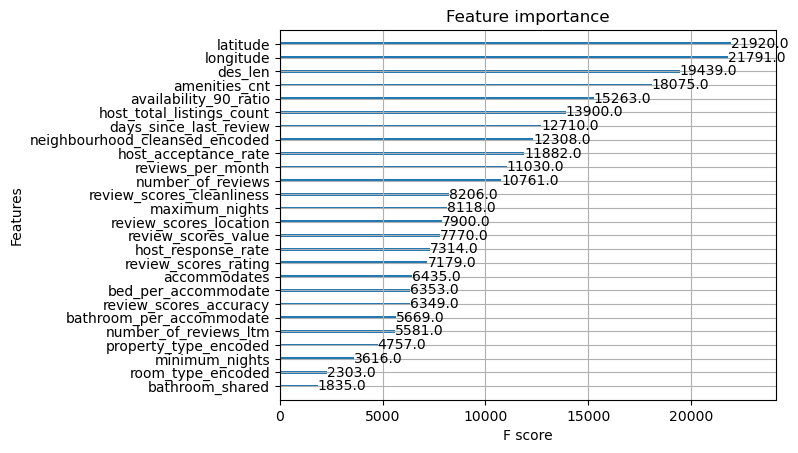

In [ ]:
from xgboost import plot_importance
plot_importance(best_xgb_reg)

In [ ]:
def convert_to_classes(y_pred):

    y_pred_round = np.round(y_pred)
    y_pred_clip = np.clip(y_pred_round, 0, 5).astype(int)

    return y_pred_clip
y_test_pred = stacking_reg.predict(test[selected_features2])
y_test_pred = convert_to_classes(y_test_pred)
submission = pd.DataFrame({
    'id': test['id'],
    'price': y_test_pred
    })
submission.to_csv('submission.csv', index=False, header=['id', 'price'])

In [ ]:
selected_features1

['host_response_rate',
 'host_acceptance_rate',
 'host_is_superhost',
 'host_total_listings_count',
 'availability_90_ratio',
 'instant_bookable',
 'minimum_nights',
 'maximum_nights',
 'number_of_reviews',
 'number_of_reviews_ltm',
 'review_scores_rating',
 'review_scores_accuracy',
 'review_scores_cleanliness',
 'review_scores_checkin',
 'review_scores_communication',
 'review_scores_location',
 'review_scores_value',
 'reviews_per_month',
 'amenities_cnt',
 'has_review',
 'neighbourhood_cleansed_encoded',
 'neighbourhood_group_cleansed_encoded',
 'room_type_encoded',
 'bathroom_shared',
 'days_since_last_review',
 'has_reviews_ltm',
 'des_len',
 'bathroom_per_accommodate',
 'bed_per_accommodate',
 'property_type_encoded',
 'latitude',
 'longitude']

# Train Neural Network Models

In [ ]:
# # Compute correlation matrix
# corr_matrix = train[selected_features2].corr().abs()

# # Identify highly correlated features (threshold > 0.8)
# high_corr_var = np.where(corr_matrix > 0.8)
# high_corr_var = [(corr_matrix.index[x], corr_matrix.columns[y]) for x, y in zip(*high_corr_var) if x != y and x < y]
# print("Highly correlated features:", high_corr_var)

Highly correlated features: [('latitude', 'geo_category'), ('reviews_per_month', 'number_of_reviews_ltm'), ('review_scores_value', 'review_scores_rating'), ('review_scores_value', 'review_scores_accuracy'), ('review_scores_rating', 'review_scores_accuracy'), ('review_scores_rating', 'review_scores_communication')]


In [ ]:
selected_features2

['longitude',
 'host_total_listings_count',
 'latitude',
 'accommodates',
 'availability_365',
 'amenities_cnt',
 'room_type_encoded',
 'host_acceptance_rate',
 'neighbourhood_cleansed_encoded',
 'days_since_last_review',
 'geo_category',
 'reviews_per_month',
 'number_of_reviews',
 'House Infrastructure',
 'bathroom_shared',
 'minimum_nights',
 'Kitchen Supplies',
 'maximum_nights',
 'host_response_rate',
 'review_scores_location',
 'review_scores_cleanliness',
 'review_scores_value',
 'number_of_reviews_ltm',
 'bathrooms',
 'review_scores_rating',
 'review_scores_accuracy',
 'Safety Features',
 'review_scores_communication',
 'review_scores_checkin']

In [ ]:
# selected_features3 = ['longitude',
#  'host_total_listings_count',
#  'latitude',
#  'accommodates',
#  'availability_365',
#  'amenities_cnt',
#  'room_type_encoded',
#  'host_acceptance_rate',
#  'neighbourhood_cleansed_encoded',
#  'days_since_last_review',
#  'reviews_per_month',
#  'number_of_reviews',
#  'House Infrastructure',
#  'bathroom_shared',
#  'minimum_nights',
#  'Kitchen Supplies',
#  'maximum_nights',
#  'host_response_rate',
#  'review_scores_location',
#  'review_scores_cleanliness',
#  'review_scores_value',
#  'bathrooms',
#  'review_scores_accuracy',
#  'Safety Features',
#  'review_scores_communication',
#  'review_scores_checkin']

In [ ]:
# import pandas as pd
# import numpy as np
# import tensorflow as tf
# from tensorflow import keras
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import Dense, Dropout
# import keras_tuner as kt
# from sklearn.model_selection import train_test_split, KFold
# from sklearn.preprocessing import StandardScaler
# from tensorflow.keras.layers import BatchNormalization
# from tensorflow.keras import regularizers
# from sklearn.metrics import root_mean_squared_error


# # 1. Data Preparation

# X, y = train[selected_features3], train['price']

# X_train_full, X_val, y_train_full, y_val = train_test_split(
#     X, y, test_size=0.2, random_state=42
# )

# # Feature scaling
# scaler = StandardScaler()
# X_train_full_scaled = scaler.fit_transform(X_train_full)
# X_val_scaled = scaler.transform(X_val)

# # Convert to NumPy arrays
# X_train_full_scaled_np = np.array(X_train_full_scaled)
# y_train_full_np = np.array(y_train_full)
# X_val_scaled_np = np.array(X_val_scaled)
# y_val_np = np.array(y_val)

# # 2. Define the Model-Building Function
# def build_model(hp):
#     model = Sequential()
#     for i in range(hp.Int('num_layers', 1, 3)):
#         model.add(Dense(
#             units=hp.Int(f'units_{i}', min_value=32, max_value=256, step=32),
#             activation=hp.Choice('activation', values=['relu', 'tanh']),
#             kernel_regularizer=regularizers.l2(0.001) # add L2 regularization
#         ))
#         model.add(BatchNormalization())
#         model.add(Dropout(rate=0.5))
#     model.add(Dense(1))
#     model.compile(
#         optimizer=keras.optimizers.Adam(
#             hp.Float('learning_rate', min_value=1e-5, max_value=1e-3, sampling='LOG')
#         ),
#         loss='mean_squared_error',
#         metrics=[tf.keras.metrics.RootMeanSquaredError()]
#     )
#     return model

# # 3. Hyperparameter Tuning

# # Initialize Keras Tuner
# tuner = kt.RandomSearch(
#     build_model,
#     objective='val_root_mean_squared_error',
#     max_trials=20,
#     executions_per_trial=1,
#     directory='keras_tuner_dir',
#     project_name='nn_regressor'
# )

# # Cross-validation setup
# kfold = KFold(n_splits=10, shuffle=True, random_state=42)

# # Function to run tuner with cross-validation
# def run_tuner_cv(tuner, X, y, kfold):
#     for train_indices, val_indices in kfold.split(X):
#         X_train_cv, X_val_cv = X[train_indices], X[val_indices]
#         y_train_cv, y_val_cv = y[train_indices], y[val_indices]

#         tuner.search(
#             X_train_cv, y_train_cv,
#             epochs=50,
#             validation_data=(X_val_cv, y_val_cv),
#             callbacks=[tf.keras.callbacks.EarlyStopping(patience=3)],
#             verbose=0
#         )

# # Run hyperparameter tuning
# run_tuner_cv(tuner, X_train_full_scaled_np, y_train_full_np, kfold)

# # Retrieve the best hyperparameters
# best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

# print(f"""
# The hyperparameter search is complete. The optimal number of layers is {best_hps.get('num_layers')} with units per layer {[best_hps.get(f'units_{i}') for i in range(best_hps.get('num_layers'))]}.
# The optimal activation function is {best_hps.get('activation')}.
# The optimal learning rate is {best_hps.get('learning_rate')}.
# """)

# # 4. Retrain the Model with Best Hyperparameters

# # Build the best model
# model = tuner.hypermodel.build(best_hps)

# # Function to train the best model with cross-validation
# def train_best_model_cv(model, X, y, kfold):
#     rmse_scores = []
#     fold = 1
#     for train_indices, val_indices in kfold.split(X):
#         print(f"Training on Fold {fold}")
#         X_train_cv, X_val_cv = X[train_indices], X[val_indices]
#         y_train_cv, y_val_cv = y[train_indices], y[val_indices]

#         history = model.fit(
#             X_train_cv, y_train_cv,
#             epochs=50,
#             validation_data=(X_val_cv, y_val_cv),
#             callbacks=[tf.keras.callbacks.EarlyStopping(patience=5)],
#             verbose=0
#         )

#         # Evaluate on validation data
#         val_rmse = min(history.history['val_root_mean_squared_error'])
#         print(f"Validation RMSE for Fold {fold}: {val_rmse:.4f}")
#         rmse_scores.append(val_rmse)
#         fold += 1

#     print(f"Average Validation RMSE: {np.mean(rmse_scores):.4f}")

# # Train the model
# train_best_model_cv(model, X_train_full_scaled_np, y_train_full_np, kfold)

# # 5. Model Evaluation

# # Predict on test data
# y_val_pred = model.predict(X_val_scaled_np).flatten()

# # Calculate RMSE
# val_rmse = root_mean_squared_error(y_val_np, y_val_pred)
# print(f"Val RMSE: {val_rmse:.4f}")

Reloading Tuner from keras_tuner_dir/nn_regressor/tuner0.json

The hyperparameter search is complete. The optimal number of layers is 3 with units per layer [256, 224, 160].
The optimal activation function is relu.
The optimal learning rate is 0.00027550606600036204.

Training on Fold 1
Validation RMSE for Fold 1: 0.8850
Training on Fold 2
Validation RMSE for Fold 2: 0.8700
Training on Fold 3
Validation RMSE for Fold 3: 0.8703
Training on Fold 4
Validation RMSE for Fold 4: 0.8490
Training on Fold 5
Validation RMSE for Fold 5: 0.8188
Training on Fold 6
Validation RMSE for Fold 6: 0.7967
Training on Fold 7
Validation RMSE for Fold 7: 0.8343
Training on Fold 8
Validation RMSE for Fold 8: 0.8022
Training on Fold 9
Validation RMSE for Fold 9: 0.7948
Training on Fold 10
Validation RMSE for Fold 10: 0.7825
Average Validation RMSE: 0.8304
99/99 ━━━━━━━━━━━━━━━━━━━━ 0s 638us/step
Val RMSE: 0.8730


In [ ]:
# def convert_to_classes(y_pred):

#     y_pred_round = np.round(y_pred)
#     y_pred_clip = np.clip(y_pred_round, 0, 5).astype(int)

#     return y_pred_clip
# # Calculate RMSE
# y_val_pred = convert_to_classes(y_val_pred)
# val_rmse = root_mean_squared_error(y_val_np, y_val_pred)
# print(f"Val RMSE: {val_rmse:.4f}")

Val RMSE: 0.9176


In [ ]:
# # Feature scaling
# scaler = StandardScaler()
# X_train_full_scaled = scaler.fit_transform(X_train_full)
# X_val_scaled = scaler.transform(X_val)

# # Convert to NumPy arrays
# X_train_full_scaled_np = np.array(X_train_full_scaled)
# y_train_full_np = np.array(y_train_full)
# X_val_scaled_np = np.array(X_val_scaled)
# y_val_np = np.array(y_val)
# y_test_pred = model.predict()
# submission = pd.DataFrame({
#     'id': test['id'],
#     'price': y_test_pred
#     })
# submission.to_csv('submission.csv', index=False, header=['id', 'price'])